# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.00005
scheduler_gamma = [0.5, 0.5, 0.7, 0.6]
scheduler_milestones = [500, 700, 1000, 1300]

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.test_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                             df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                             rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
validation = False 
data = summary_models.run_evaluation_get_n(n=100, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


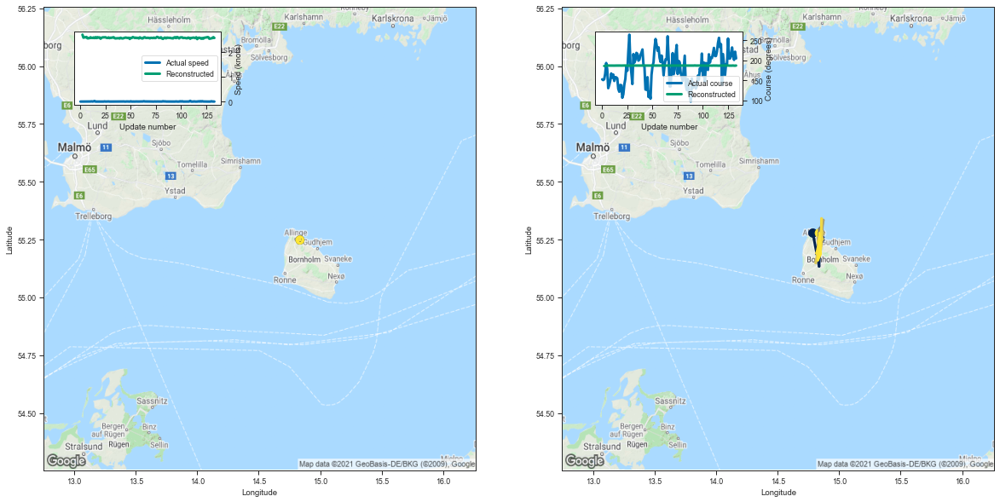

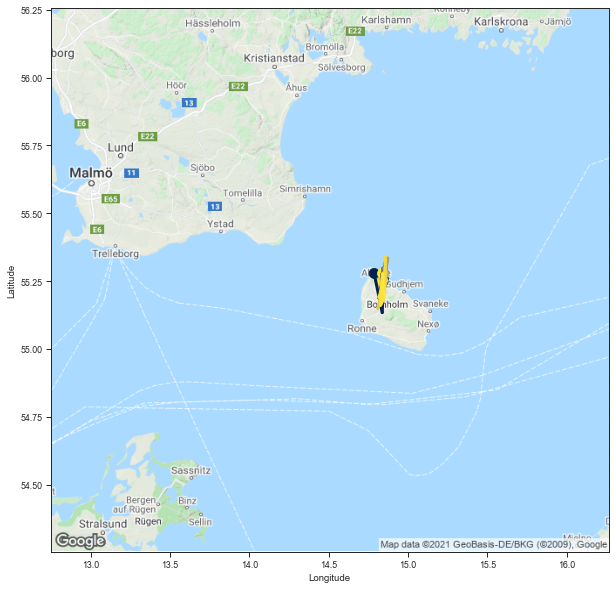

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  1987202  230069190  14.835599  55.247890  0.000000   
1                 0  1987202  230069190  14.835591  55.247890  0.000000   
2                 0  1987202  230069190  14.835593  55.247894  0.000000   
3                 0  1987202  230069190  14.835600  55.247902  0.000000   
4                 0  1987202  230069190  14.835605  55.247894  0.000000   
..              ...      ...        ...        ...        ...       ...   
129               0  1987202  230069190  14.835600  55.247890  0.000000   
130               0  1987202  230069190  14.835610  55.247898  0.011864   
131               0  1987202  230069190  14.835604  55.247902  0.003333   
132               0  1987202  230069190  14.835631  55.247913  0.000000   
133               0  1987202  230069190  14.835661  55.247921  0.000000   

         Course Ship type  Track length          Time stamp  
0    152.966660   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.786197,55.278217,2.707462,186.255829,0.023466,0.073961,3.294753,99.883932
3,14.837336,55.133694,2.583606,186.654221,0.017697,0.048775,3.213820,100.112495
4,14.843978,55.242020,2.602574,187.127991,0.016964,0.044491,3.231053,100.376902
5,14.846490,55.254753,2.594442,187.240570,0.016927,0.044682,3.208872,100.430207
6,14.857331,55.321072,2.613931,187.383972,0.017297,0.045695,3.229427,100.488708
...,...,...,...,...,...,...,...,...
129,14.827617,55.202785,2.547771,187.081284,0.016122,0.043613,3.188089,100.354669
130,14.842104,55.268349,2.559306,187.348969,0.016249,0.044449,3.192010,100.469688
131,14.826839,55.160625,2.565624,186.935989,0.016510,0.044416,3.201630,100.271774
132,14.849648,55.188332,2.605564,186.986359,0.017060,0.045924,3.213593,100.310874


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(0)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


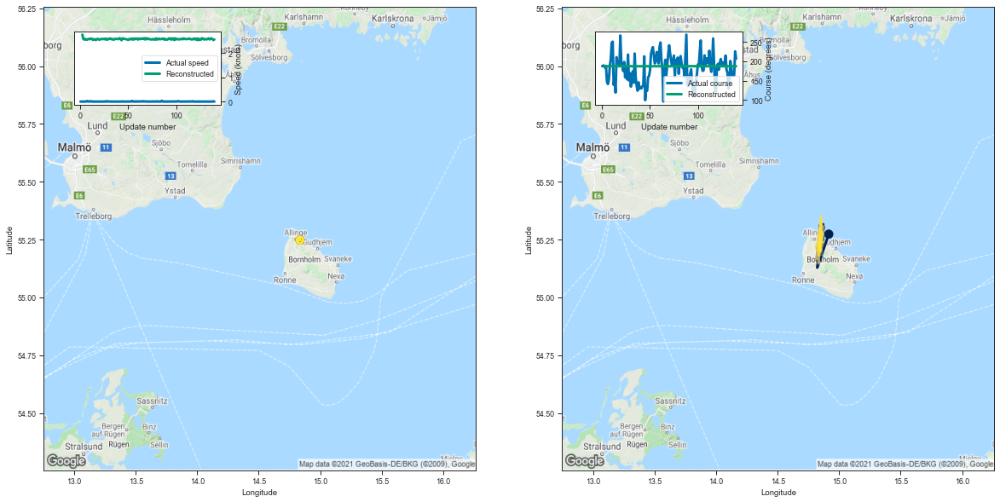

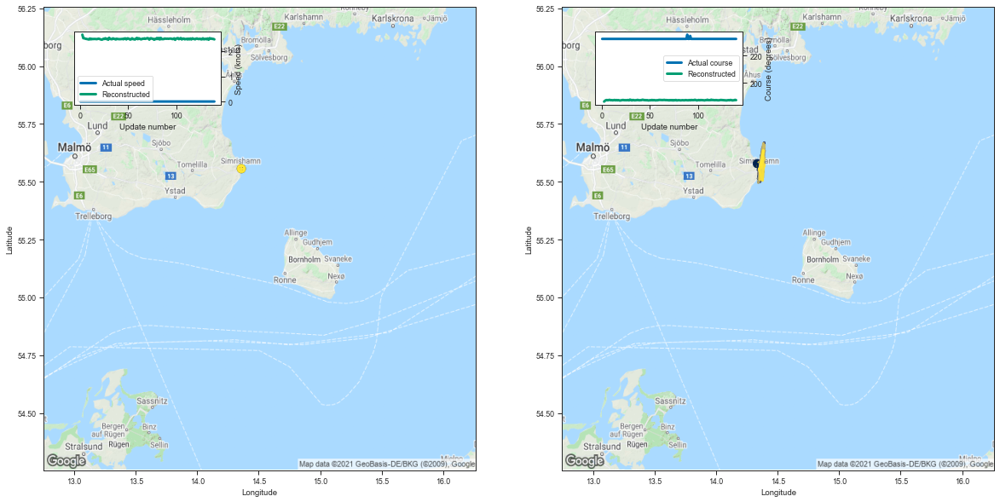

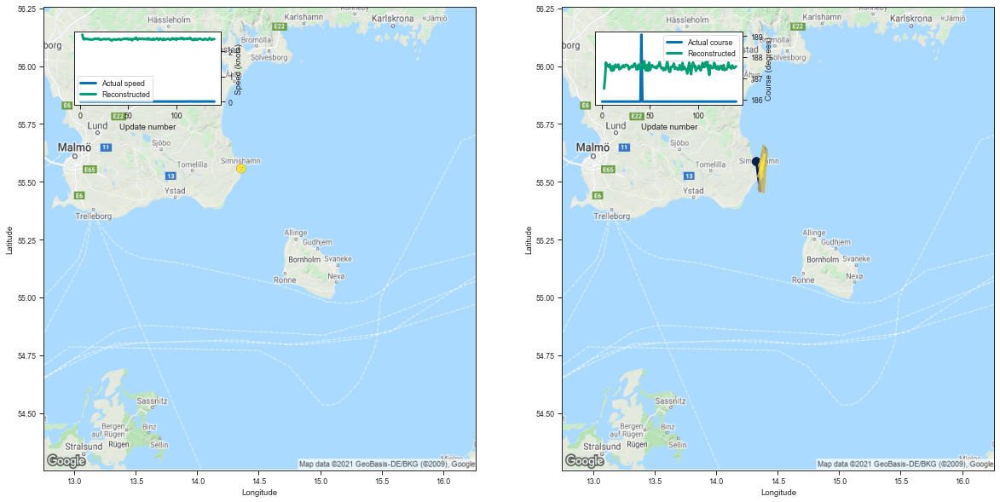

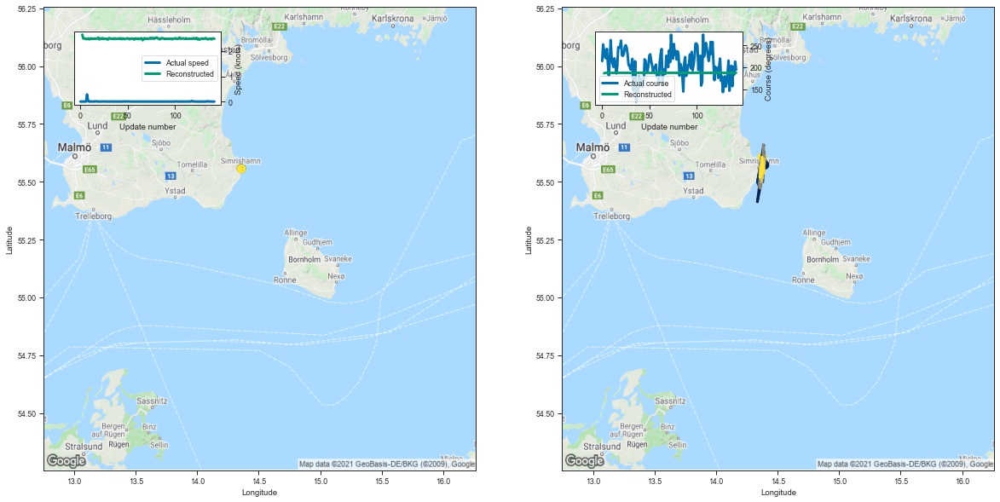

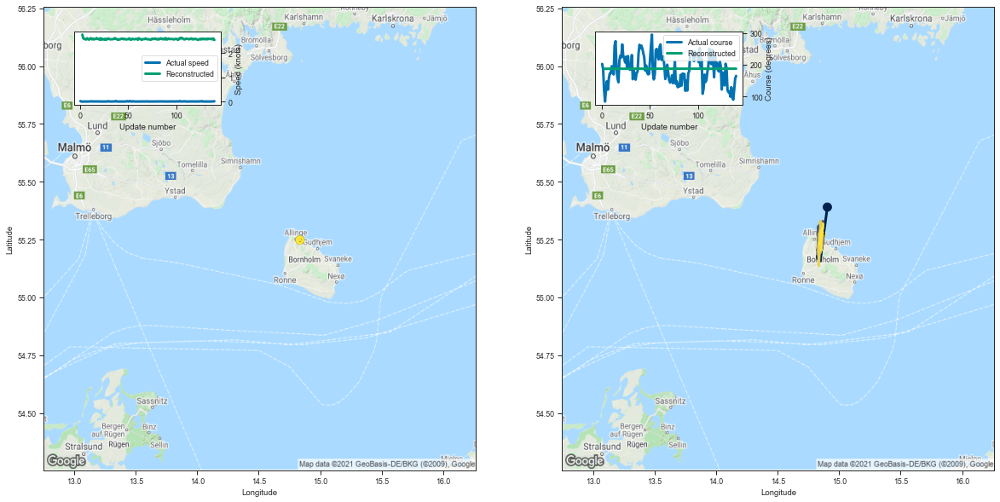

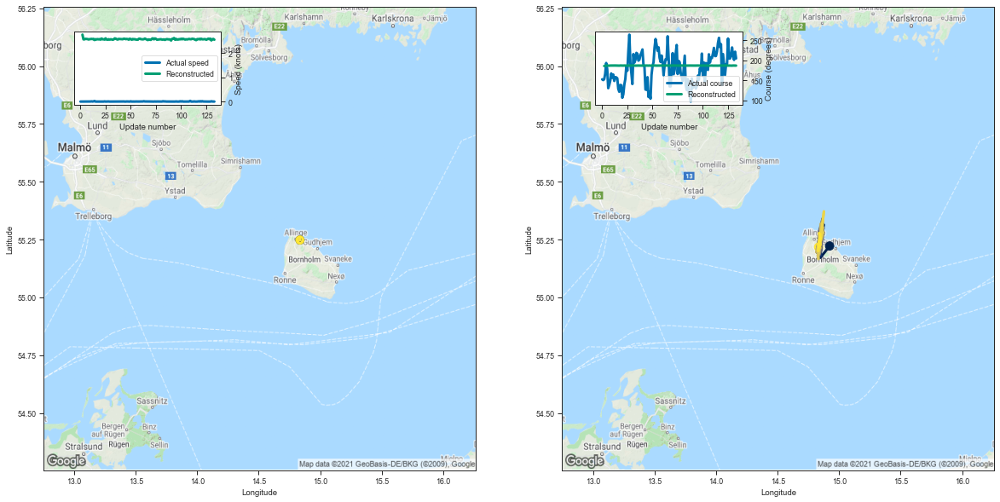

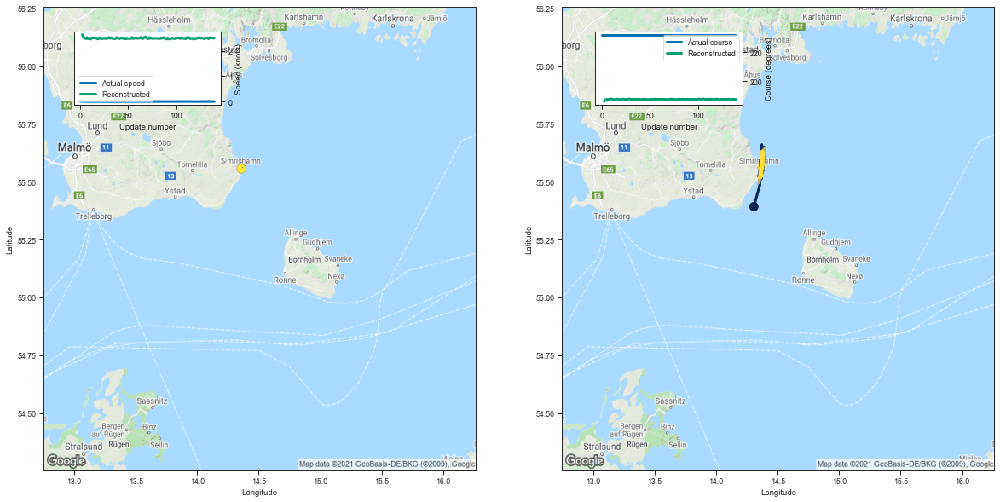

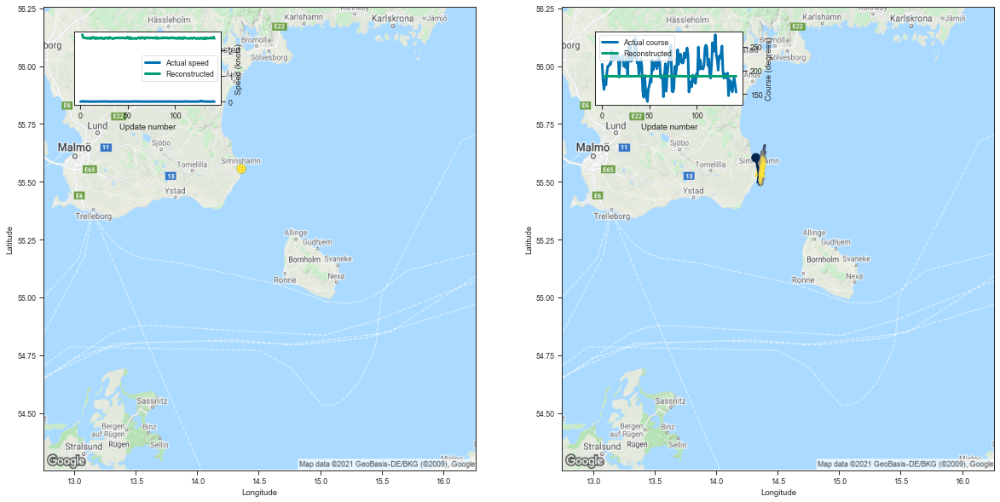

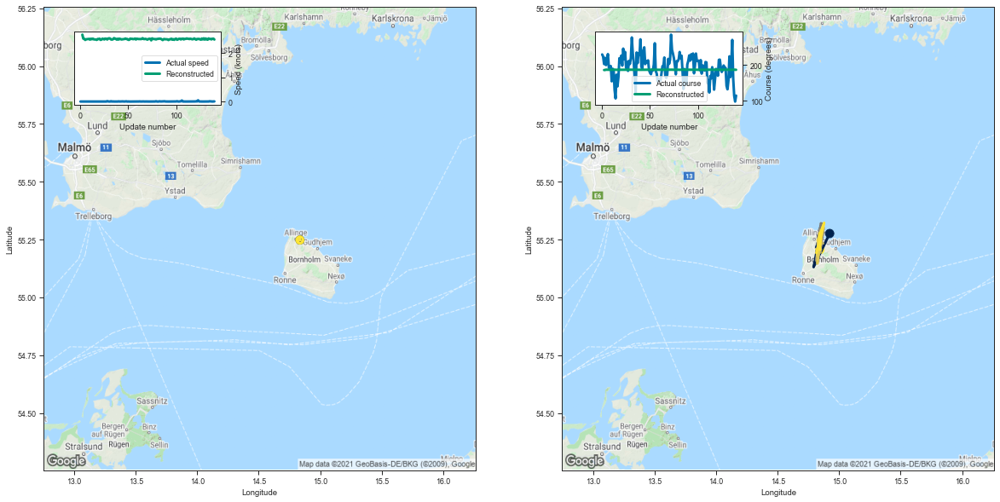

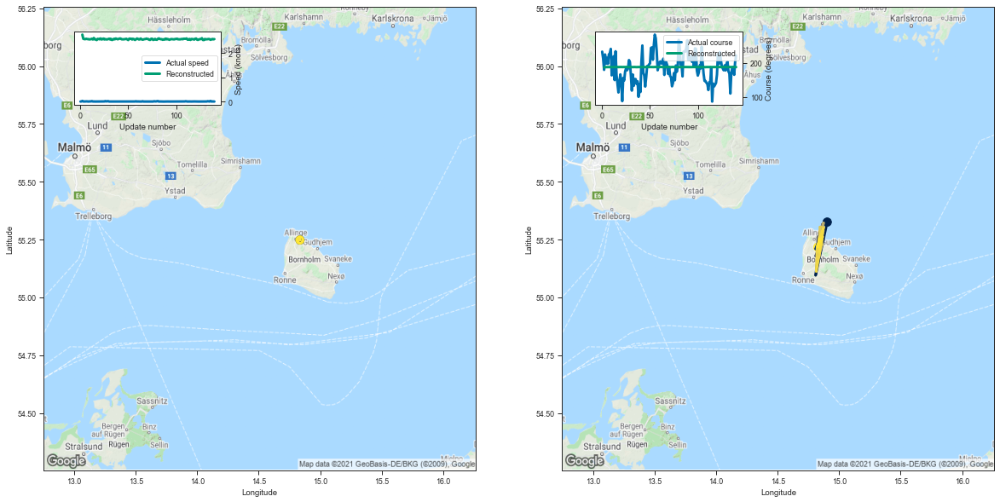

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
44,44,2004919,230069190,Fishing,141,-494.494965,-3.507056
106,106,6344170,265755000,Fishing,141,-495.307068,-3.512816
101,101,6271538,265755000,Fishing,141,-502.020935,-3.560432
58,58,6759536,265759000,Fishing,143,-511.364929,-3.575979
49,49,2150183,230069190,Fishing,141,-506.262238,-3.590512
85,85,1987202,230069190,Fishing,134,-483.158234,-3.605658
94,94,6371407,265755000,Fishing,141,-509.334717,-3.612303
105,105,6916021,265759000,Fishing,143,-517.201843,-3.616796
34,34,2077551,230069190,Fishing,141,-511.210632,-3.625607
104,104,2250052,230069190,Fishing,141,-512.172302,-3.632428


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


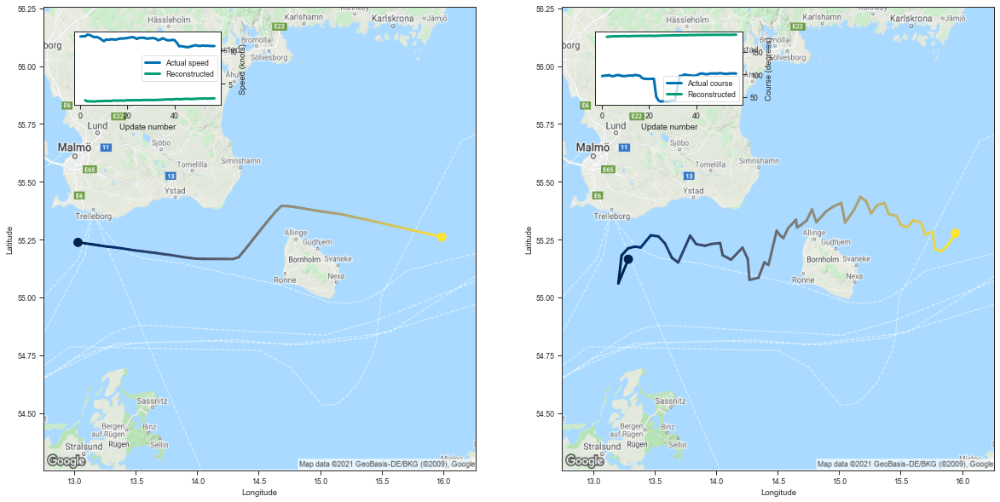

[2.4831182956695557, 2.3156673908233643, 2.327036142349243, 2.317258596420288]


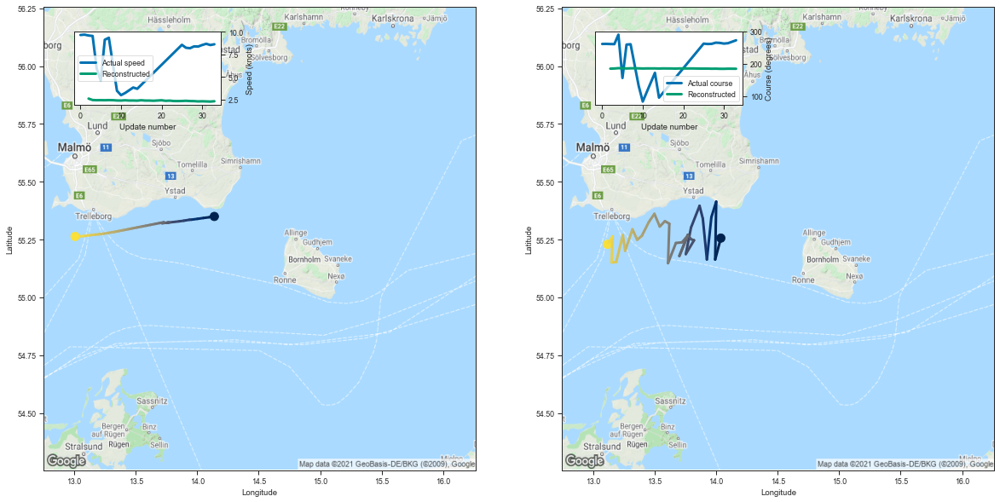

[2.595987558364868, 2.4366161823272705, 2.417720079421997, 2.423231363296509]


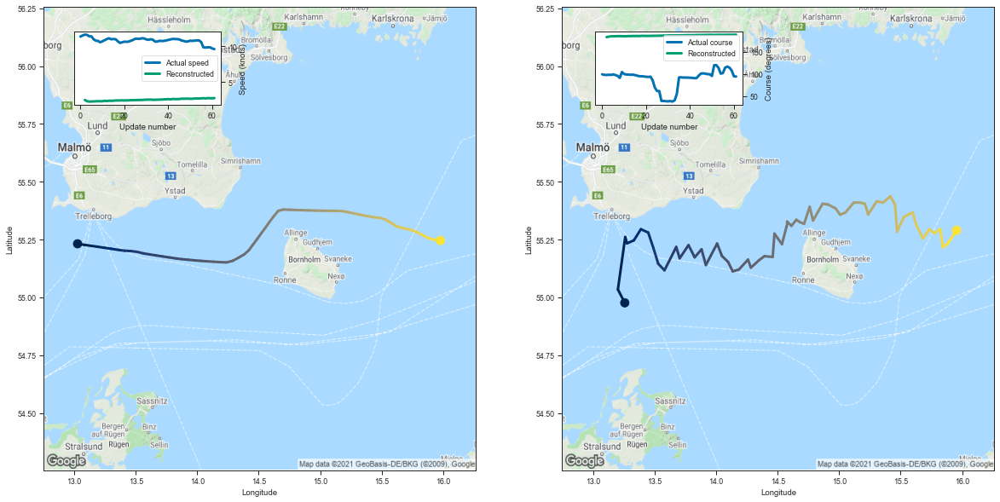

[2.51090931892395, 2.3308398723602295, 2.284045934677124, 2.2947986125946045]


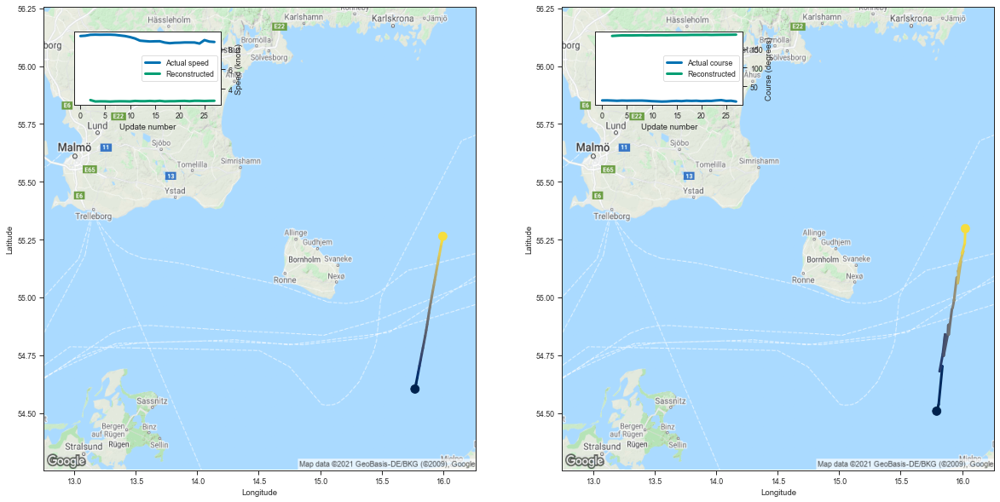

[2.8795931339263916, 2.734182119369507, 2.7499096393585205, 2.7453720569610596]


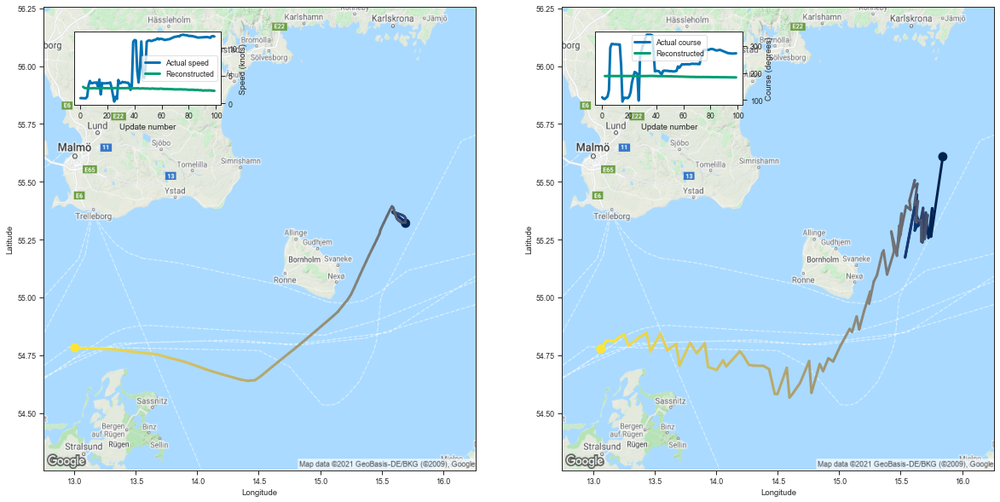

[2.974360227584839, 2.776400327682495, 2.741204023361206, 2.733696699142456]


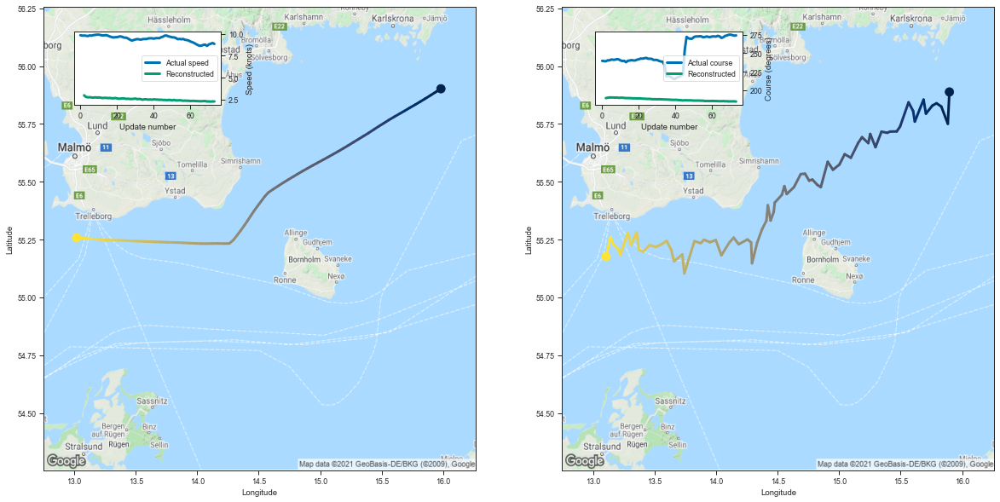

[2.9866602420806885, 2.806236505508423, 2.7599031925201416, 2.773148775100708]


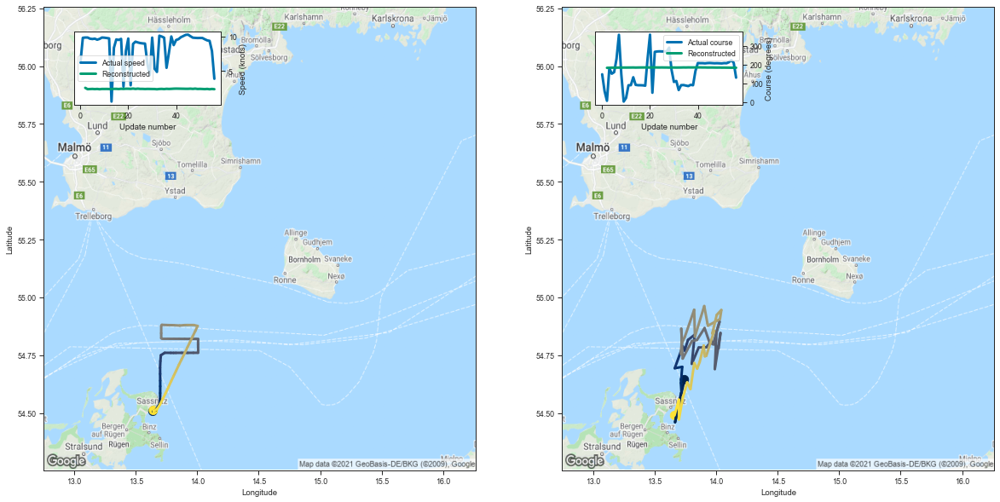

[2.562549352645874, 2.3665921688079834, 2.3872640132904053, 2.4048311710357666]


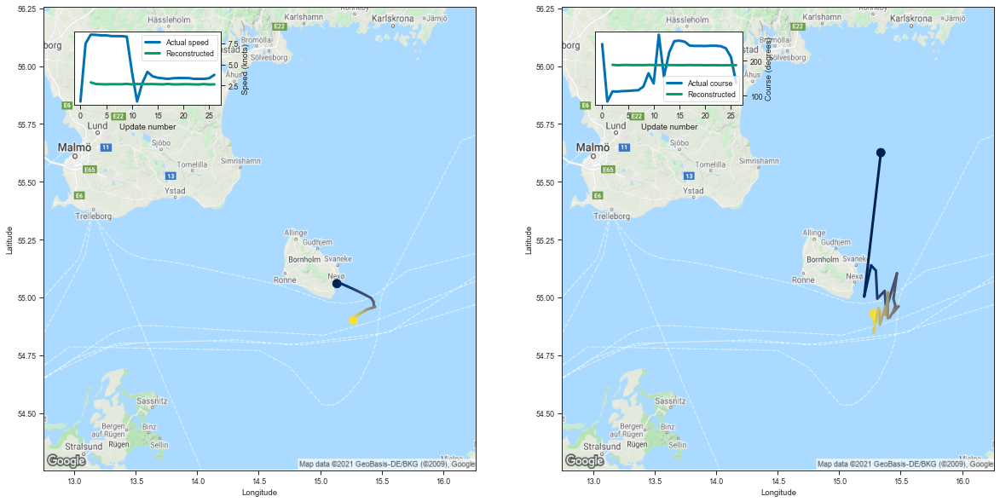

[2.8851864337921143, 2.6988399028778076, 2.6694581508636475, 2.6520817279815674]


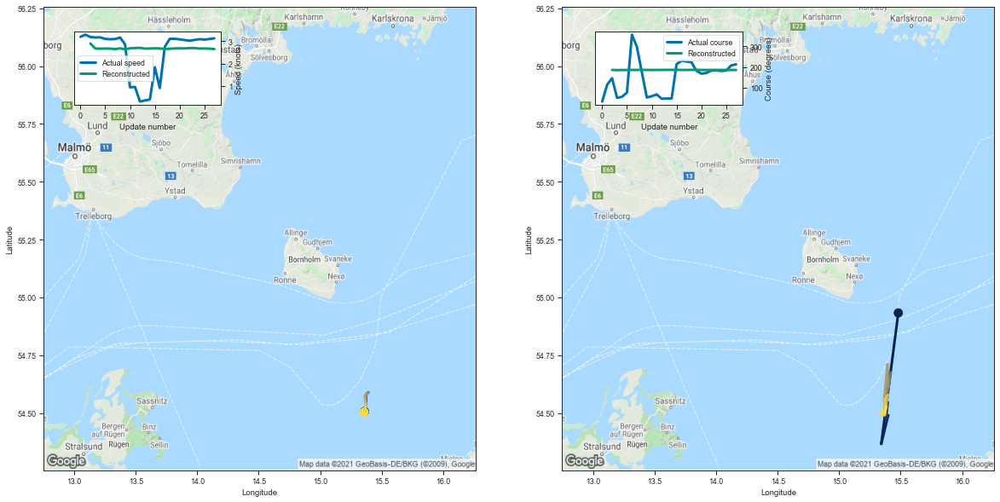

[2.9034512042999268, 2.678224802017212, 2.671215295791626, 2.676623582839966]


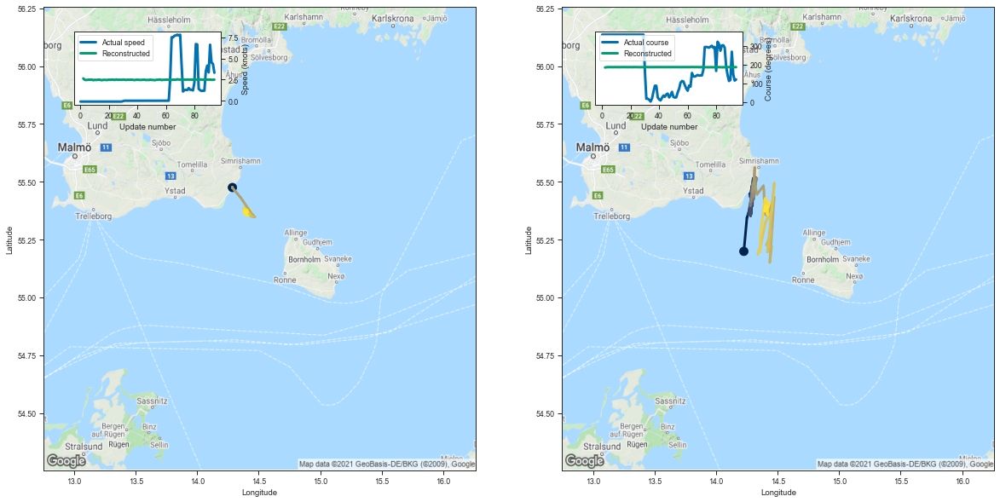

[2.6478612422943115, 2.4817092418670654, 2.4589507579803467, 2.47586989402771]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
64,64,8006943,273537800,Fishing,58,-570.456604,-9.835459
100,100,7035686,265759000,Fishing,34,-299.414795,-8.806317
59,59,8015021,273538800,Fishing,62,-526.651733,-8.494383
68,68,4367496,261015270,Fishing,28,-221.406189,-7.907364
90,90,12992,211215500,Fishing,100,-762.966309,-7.629663
86,86,2299304,230941650,Fishing,74,-514.946533,-6.958737
111,111,1126244,211542610,Fishing,57,-396.458252,-6.955408
5,5,460005,211317720,Fishing,27,-179.839066,-6.660706
110,110,2953174,261002420,Fishing,28,-164.609634,-5.878916
60,60,4677981,265551874,Fishing,95,-528.108887,-5.559041


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


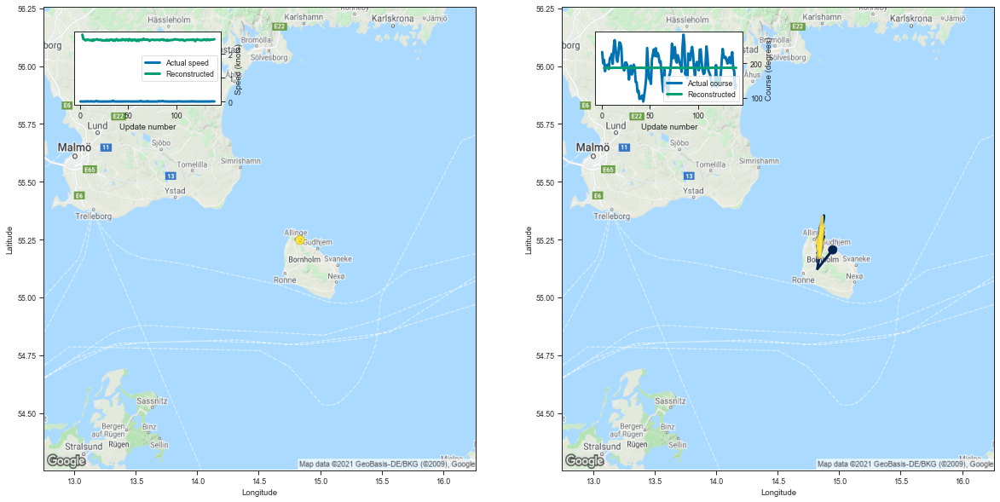

[2.800835371017456, 2.6184942722320557, 2.6011836528778076, 2.5649077892303467]


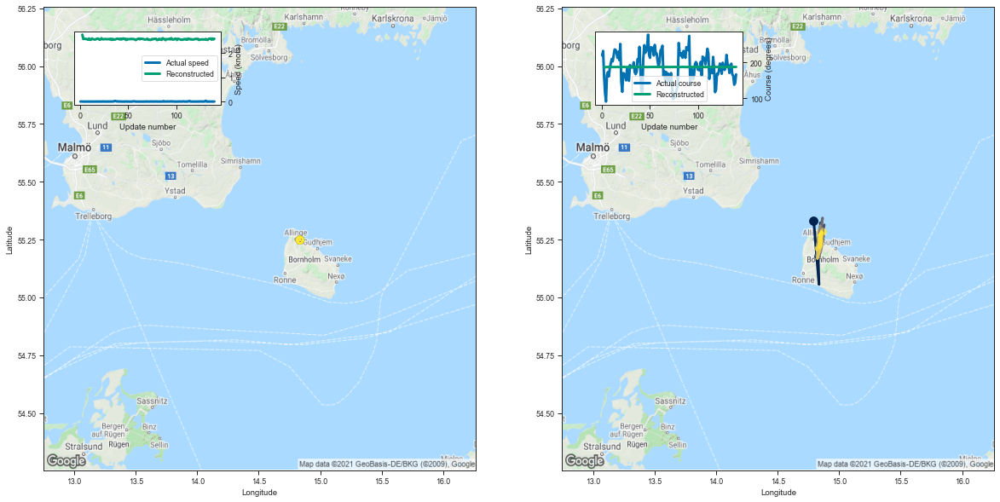

[2.765855550765991, 2.58427357673645, 2.598403215408325, 2.5863354206085205]


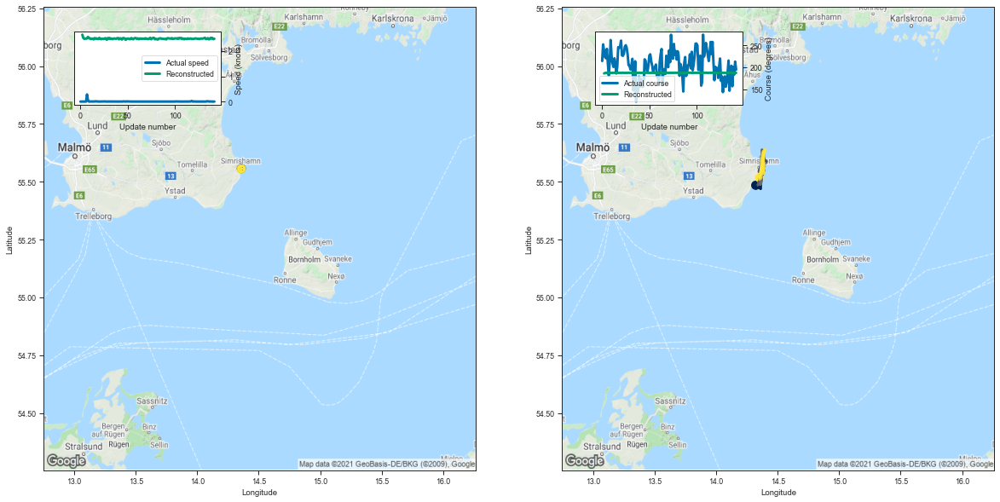

[2.655085325241089, 2.5267751216888428, 2.490183115005493, 2.4985082149505615]


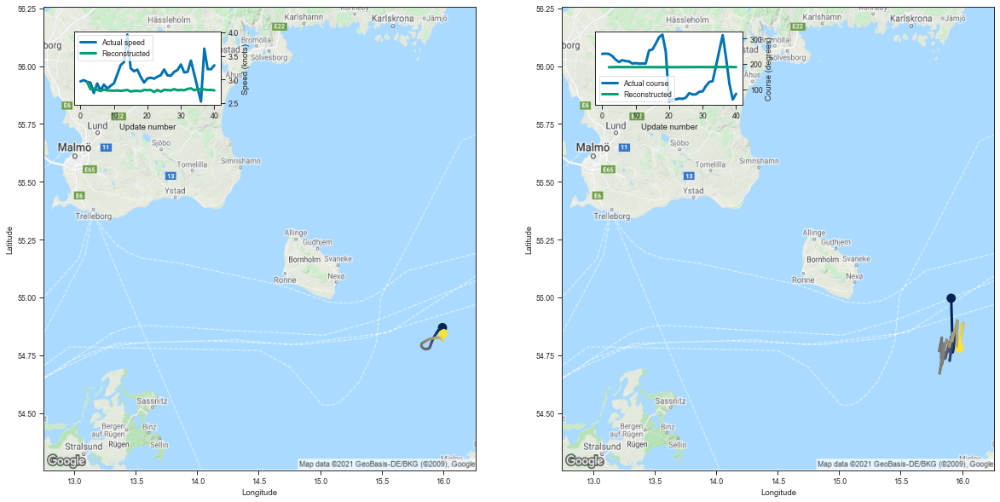

[2.9424235820770264, 2.791851758956909, 2.806757688522339, 2.785370111465454]


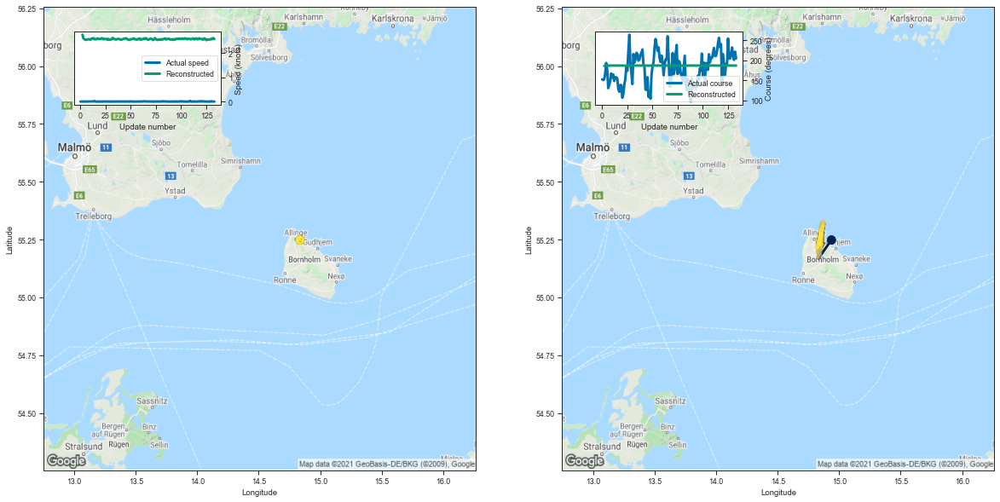

[2.7604825496673584, 2.607764959335327, 2.5692360401153564, 2.542283296585083]


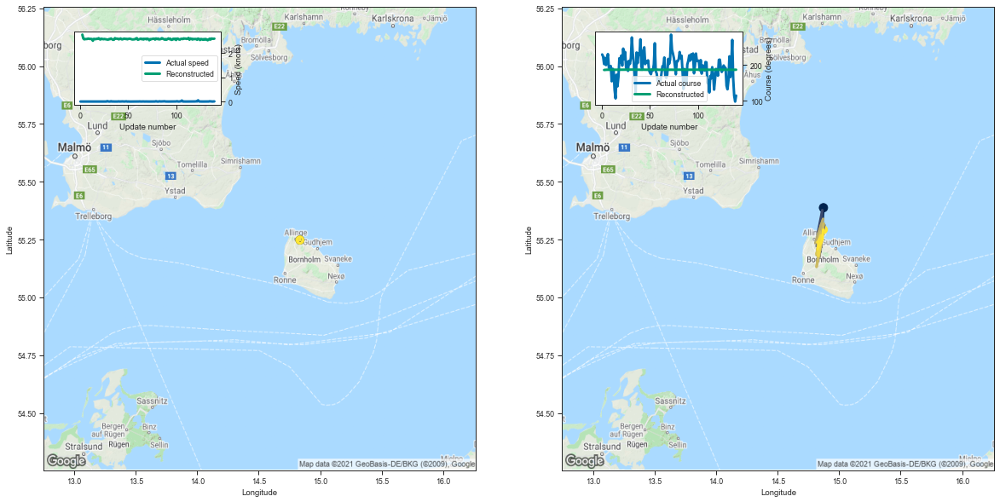

[2.7594492435455322, 2.601708173751831, 2.5661118030548096, 2.5755202770233154]


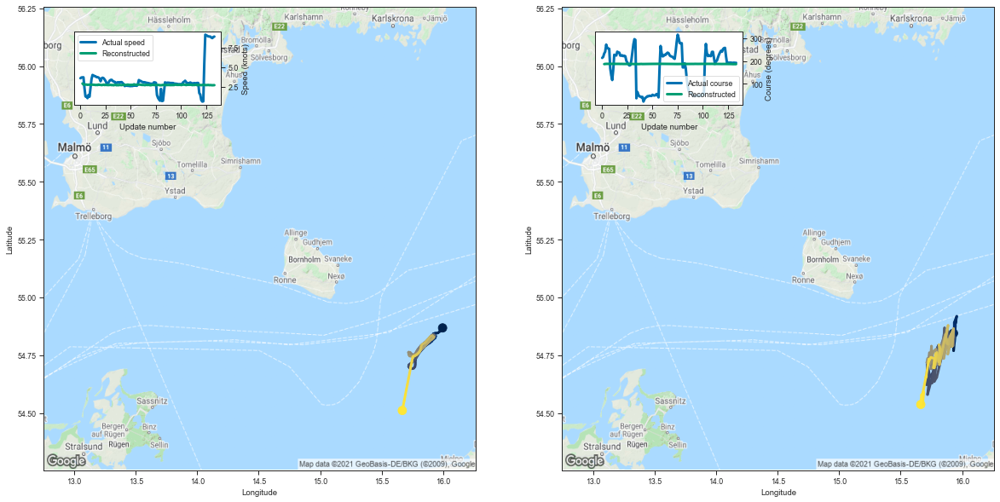

[2.934608221054077, 2.8033711910247803, 2.7882115840911865, 2.799848794937134]


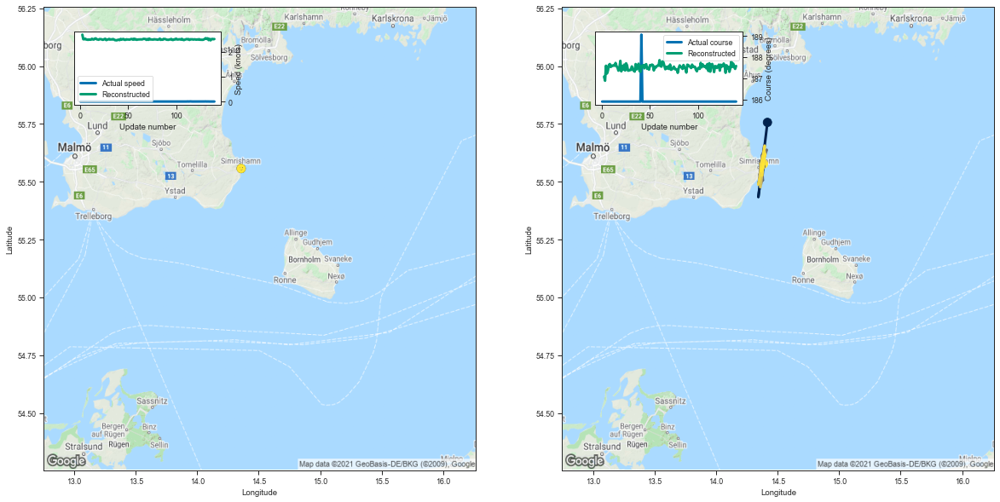

[2.6881906986236572, 2.5021440982818604, 2.500990152359009, 2.52787709236145]


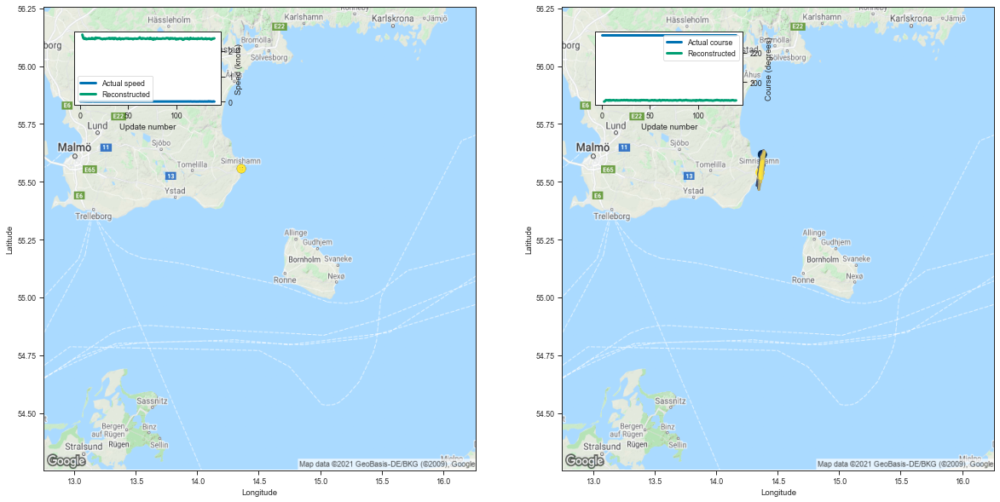

[2.6517155170440674, 2.5162932872772217, 2.481877088546753, 2.5112802982330322]


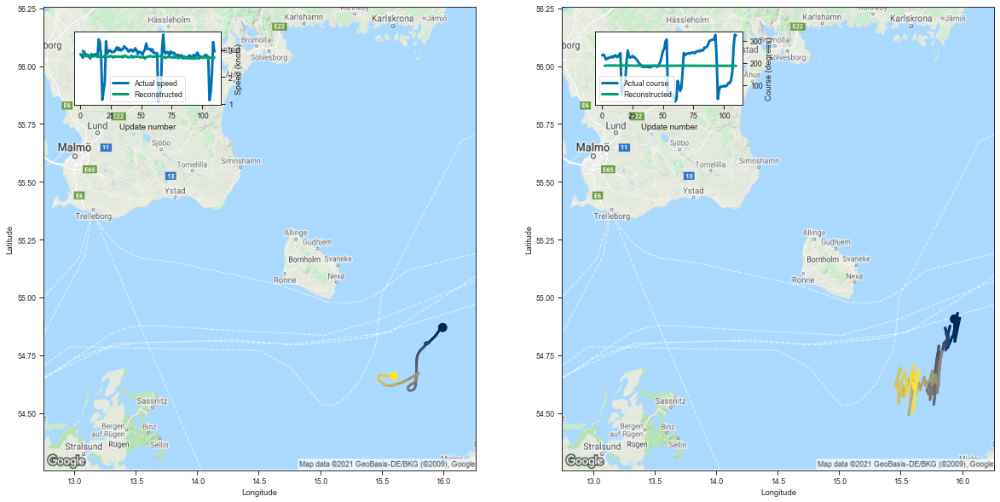

[2.961500406265259, 2.821544885635376, 2.778808355331421, 2.762624502182007]


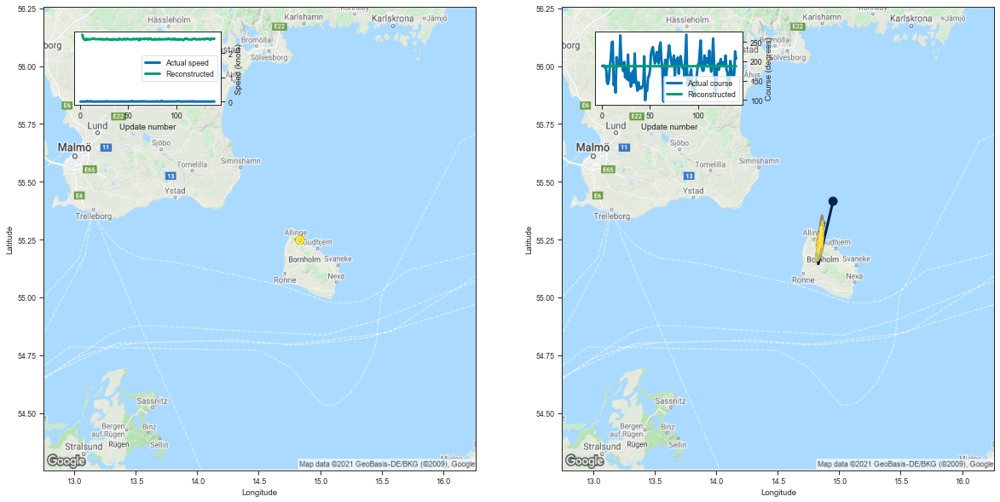

[2.769388437271118, 2.615246057510376, 2.574834108352661, 2.5401289463043213]


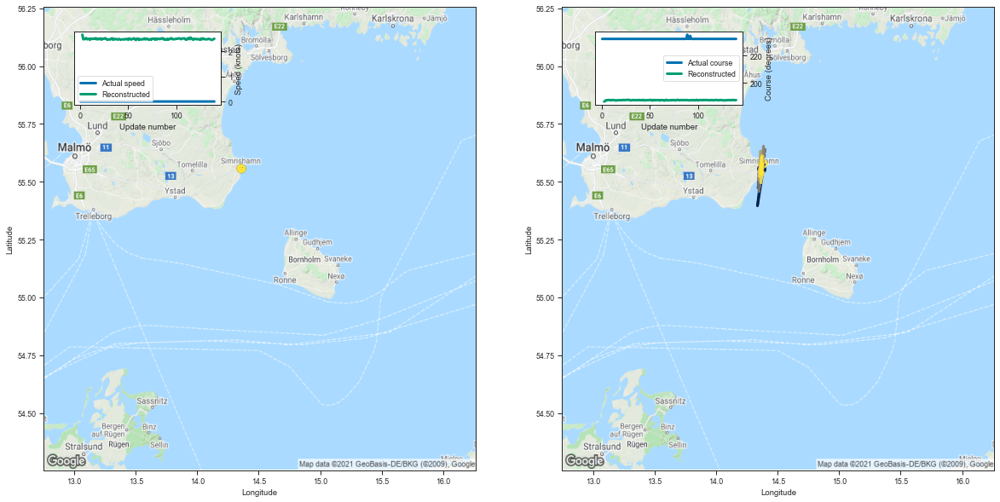

[2.6699821949005127, 2.4838640689849854, 2.494610548019409, 2.4934518337249756]


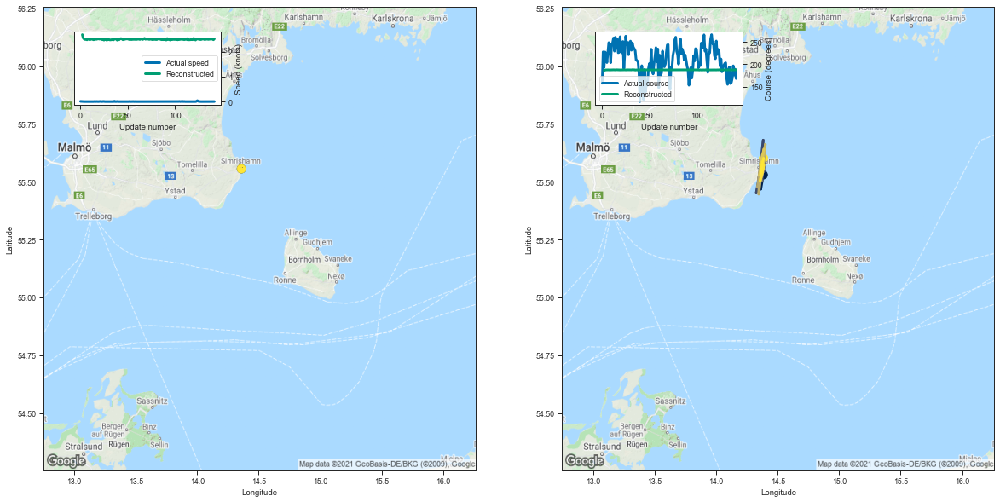

[2.680737257003784, 2.541564702987671, 2.5038883686065674, 2.4866669178009033]


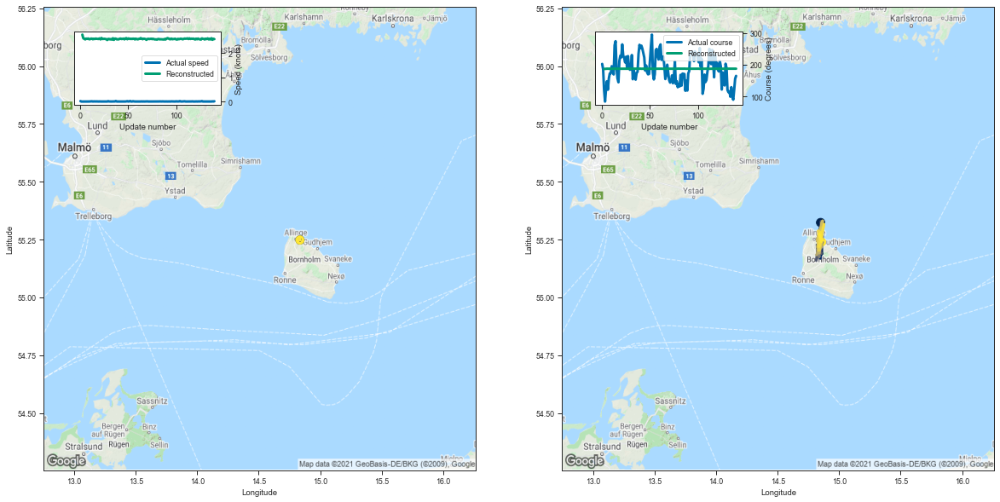

[2.754929780960083, 2.604346513748169, 2.583033800125122, 2.5582354068756104]


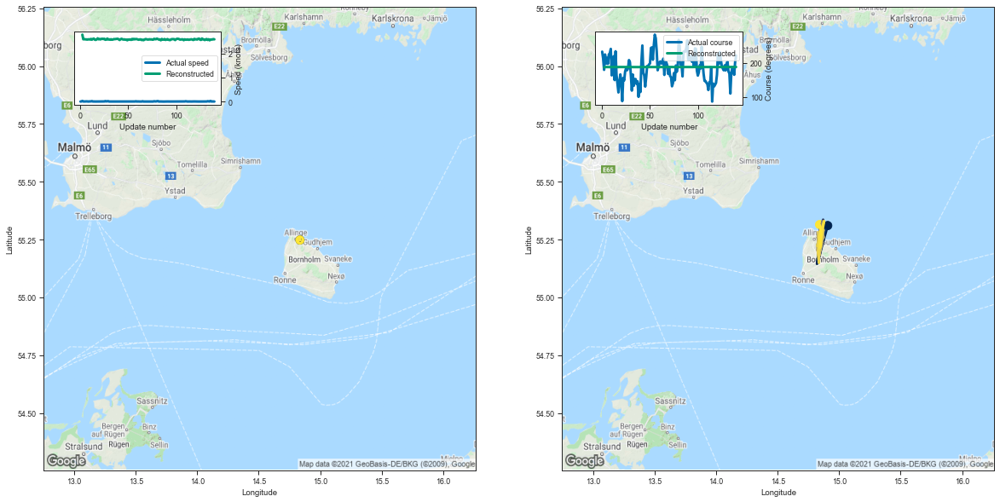

[2.7754900455474854, 2.5802323818206787, 2.5885417461395264, 2.579289197921753]


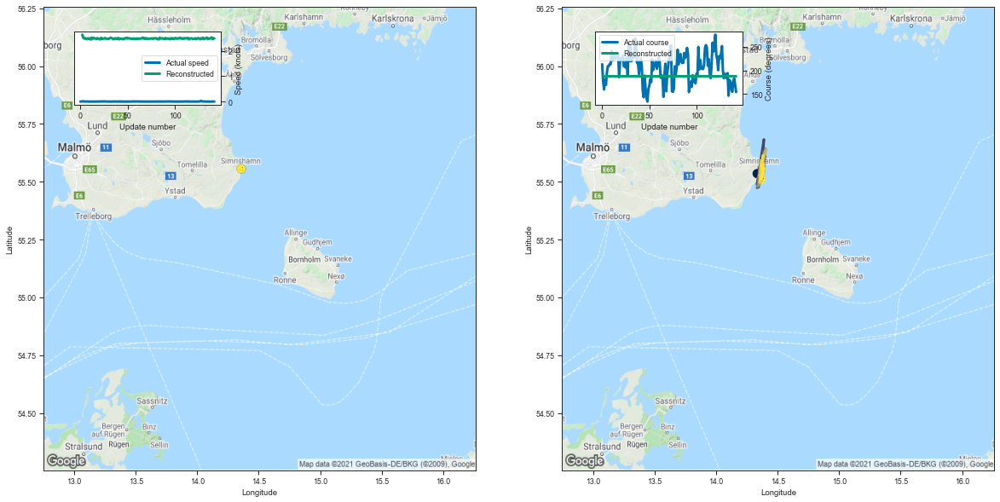

[2.646919012069702, 2.52266526222229, 2.494159460067749, 2.5101983547210693]


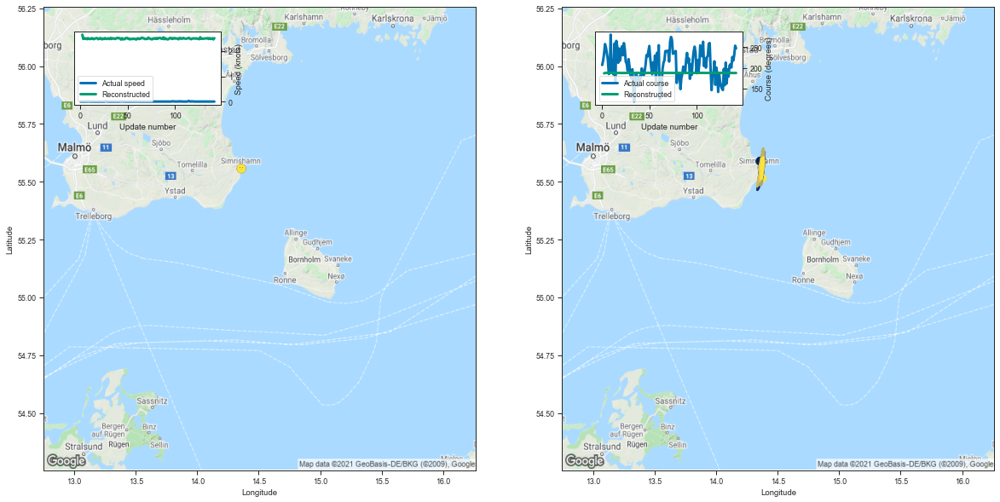

[2.6511070728302, 2.478929281234741, 2.511772871017456, 2.4913923740386963]


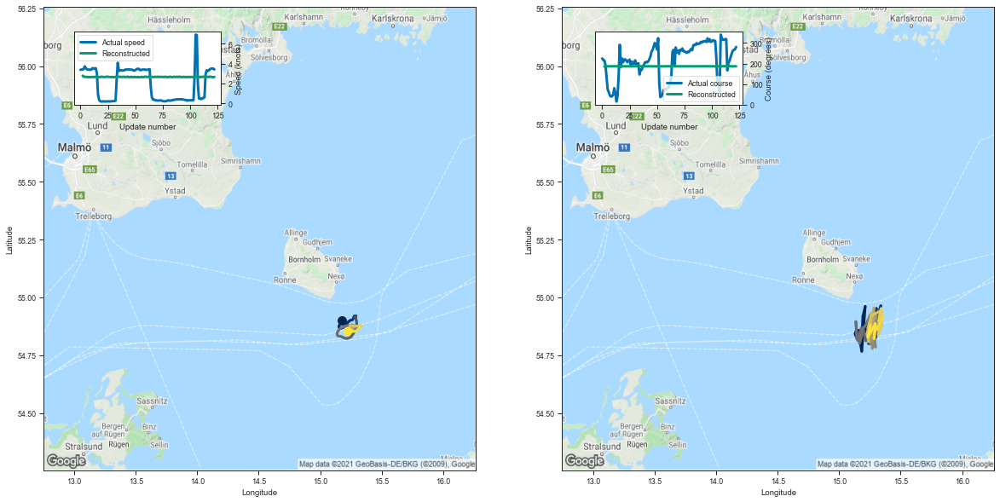

[2.781928300857544, 2.6866676807403564, 2.6485512256622314, 2.6700074672698975]


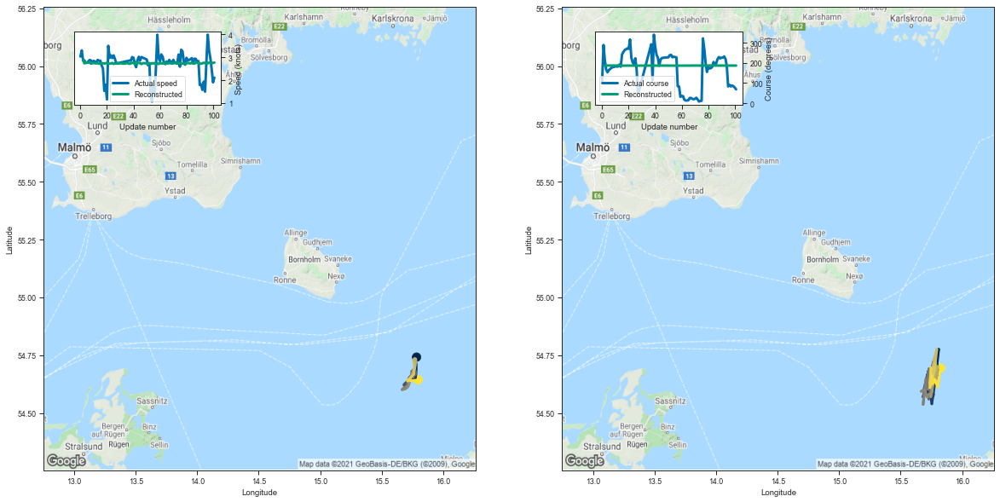

[2.8835318088531494, 2.7356321811676025, 2.774251699447632, 2.7639477252960205]


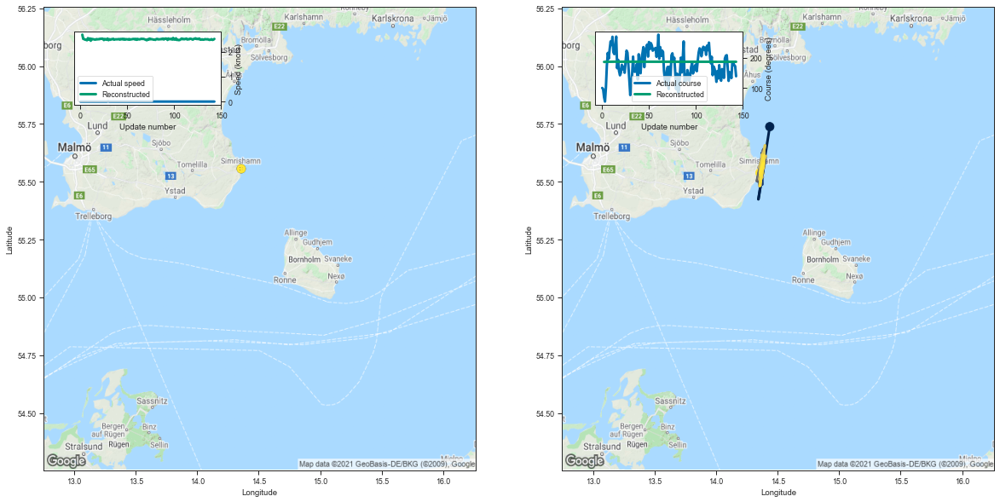

[2.6785237789154053, 2.506295919418335, 2.500685930252075, 2.4750325679779053]


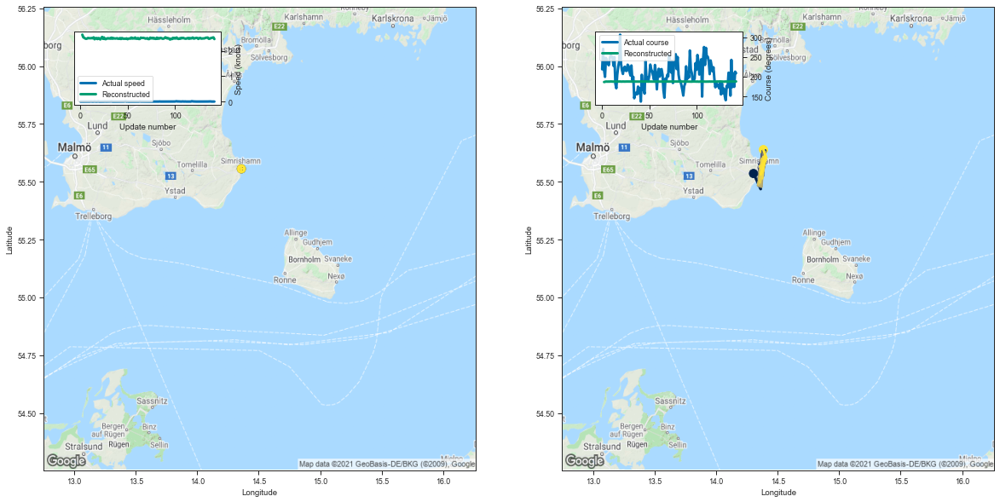

[2.642852544784546, 2.538252115249634, 2.517547845840454, 2.491661310195923]


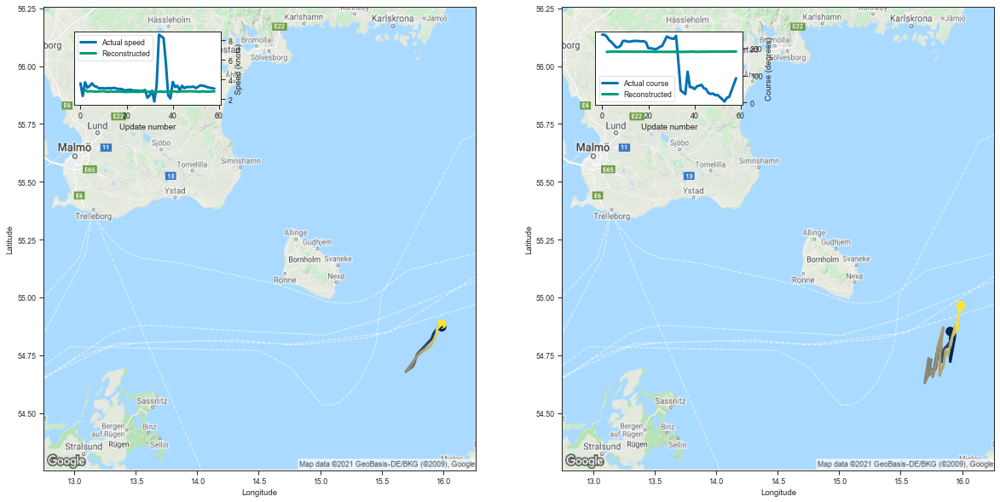

[2.9173576831817627, 2.7638609409332275, 2.794548749923706, 2.7841107845306396]


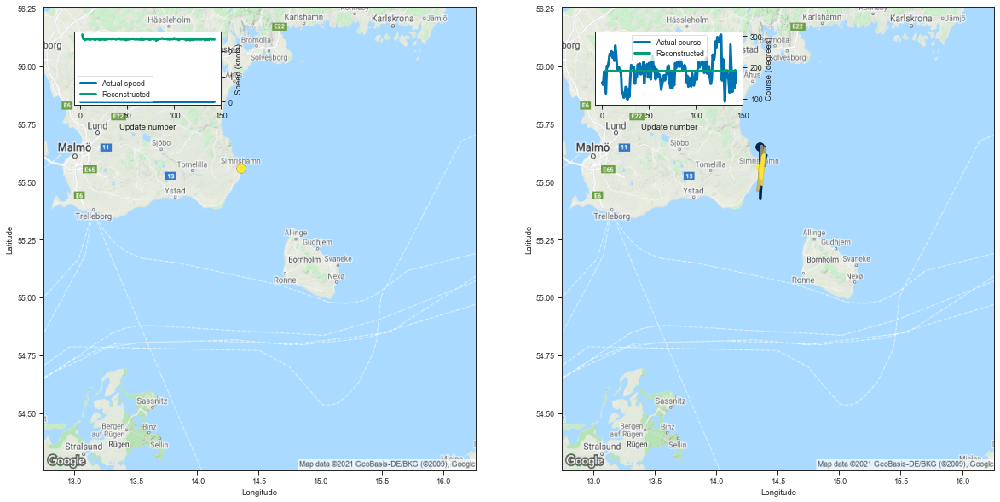

[2.674015760421753, 2.5080325603485107, 2.503382444381714, 2.4592368602752686]


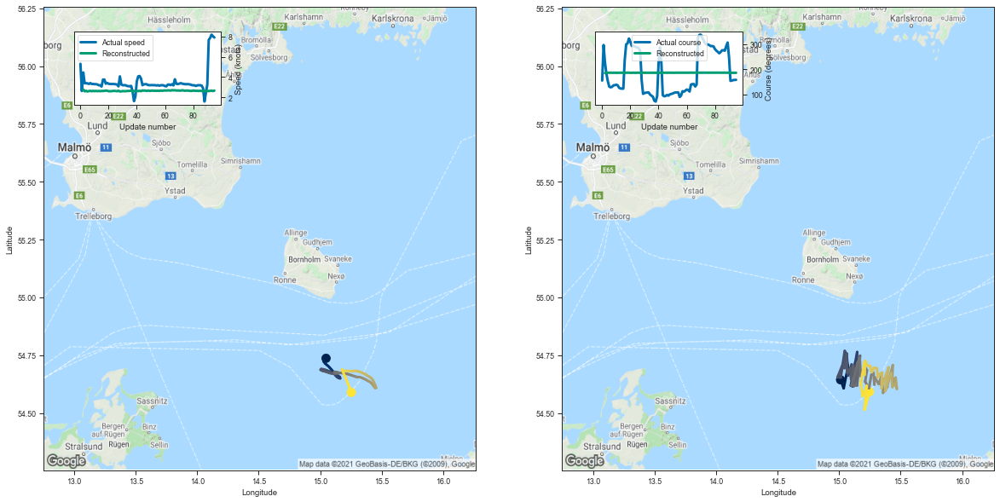

[2.775973081588745, 2.595581293106079, 2.6395866870880127, 2.582273244857788]


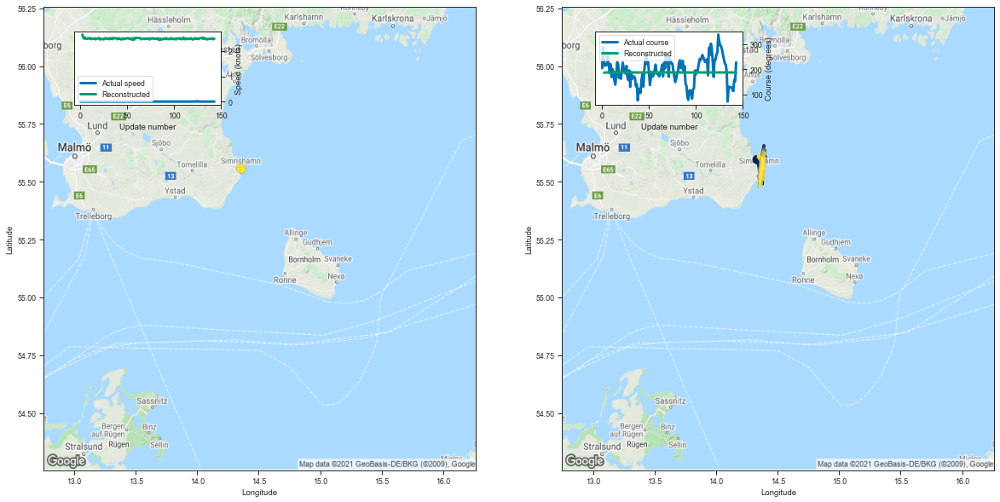

[2.6564409732818604, 2.5420258045196533, 2.498189687728882, 2.5381247997283936]


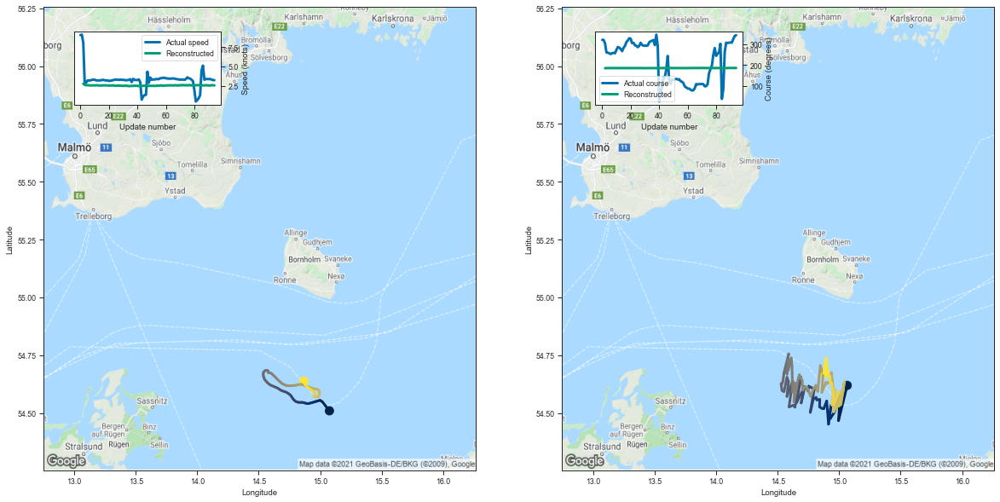

[2.7902657985687256, 2.6524579524993896, 2.6123998165130615, 2.622586965560913]


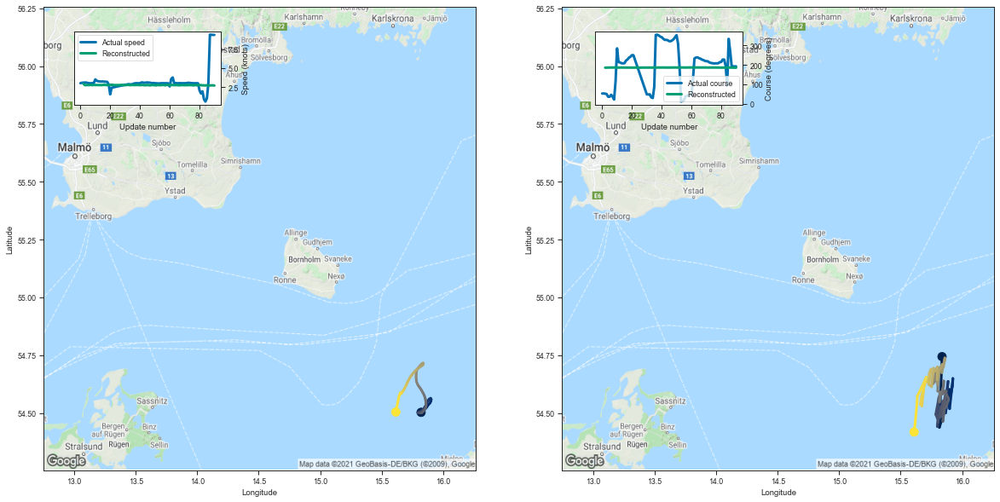

[2.9354169368743896, 2.7430813312530518, 2.7520482540130615, 2.767117738723755]


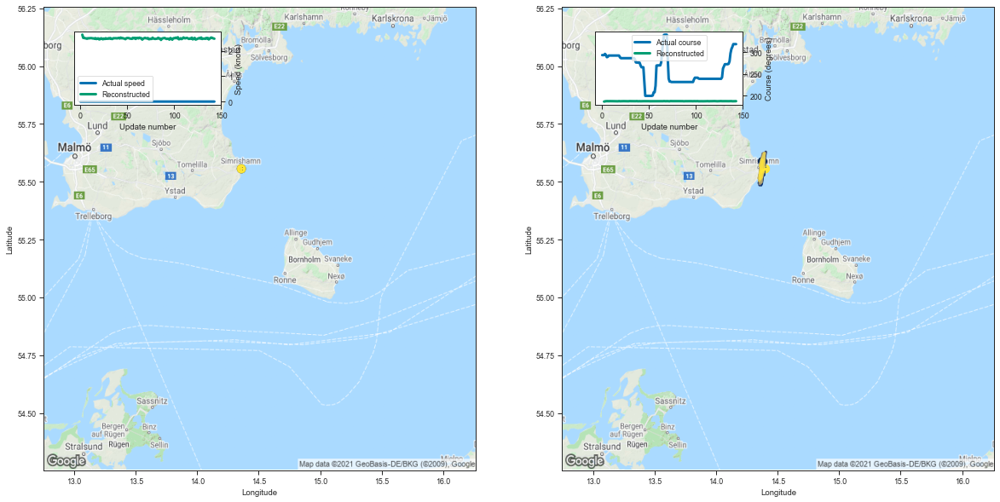

[2.643704652786255, 2.5143487453460693, 2.5188891887664795, 2.5002834796905518]


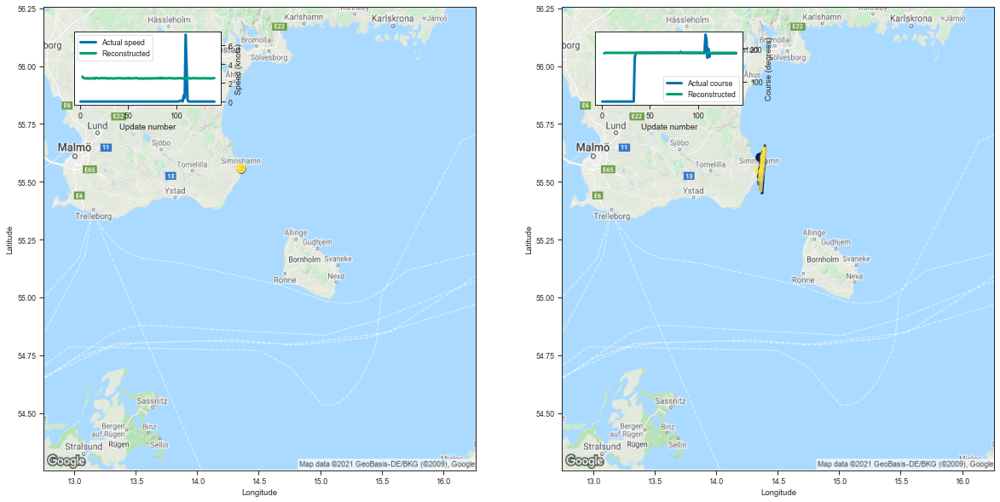

[2.6789820194244385, 2.524223566055298, 2.514526128768921, 2.4788448810577393]


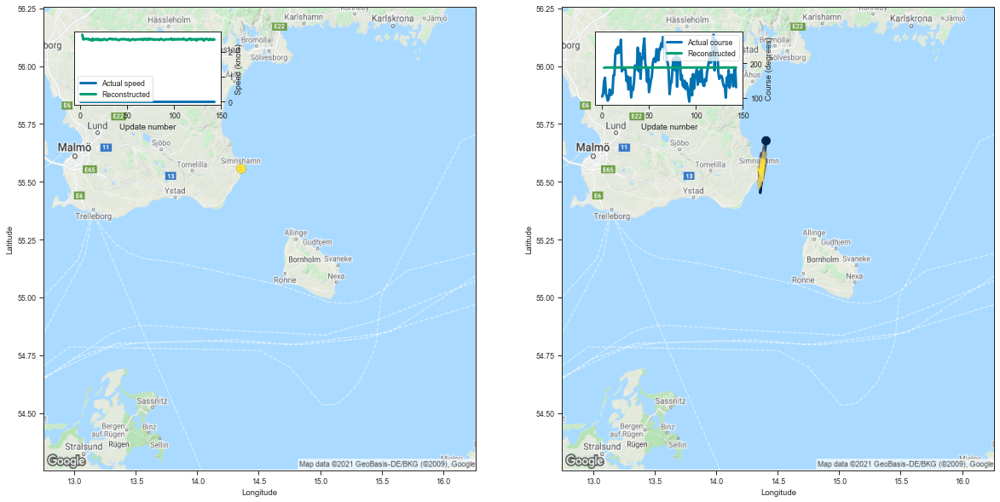

[2.685765027999878, 2.4952046871185303, 2.5012476444244385, 2.5116207599639893]


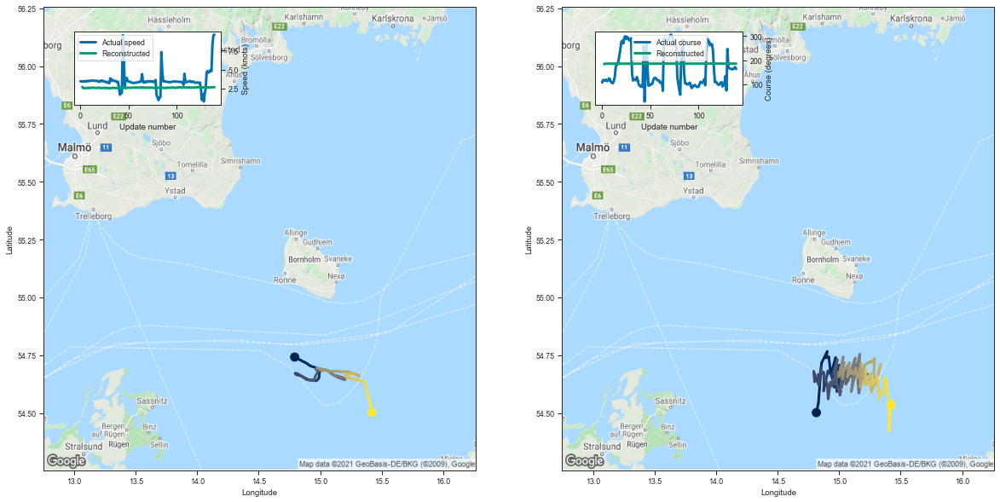

[2.732980489730835, 2.5592658519744873, 2.5809385776519775, 2.57807993888855]


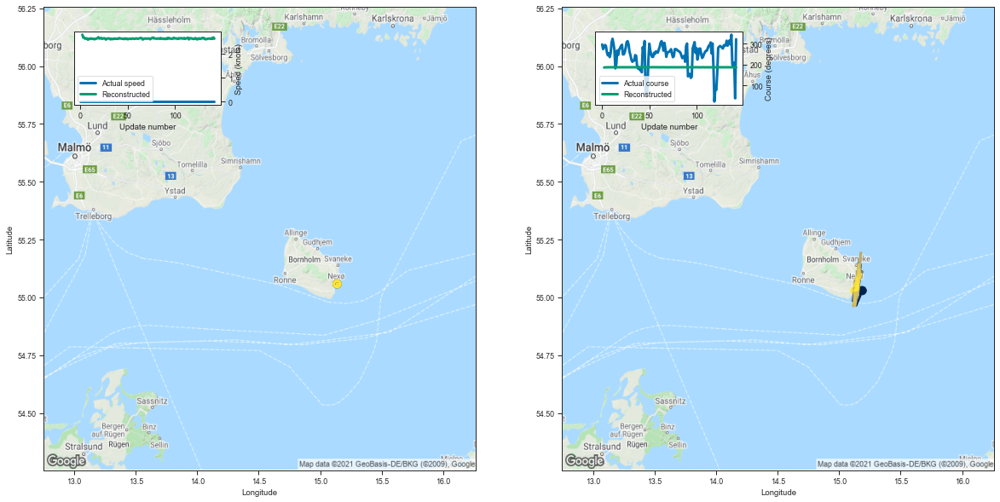

[2.799168825149536, 2.67452073097229, 2.6752707958221436, 2.6279633045196533]


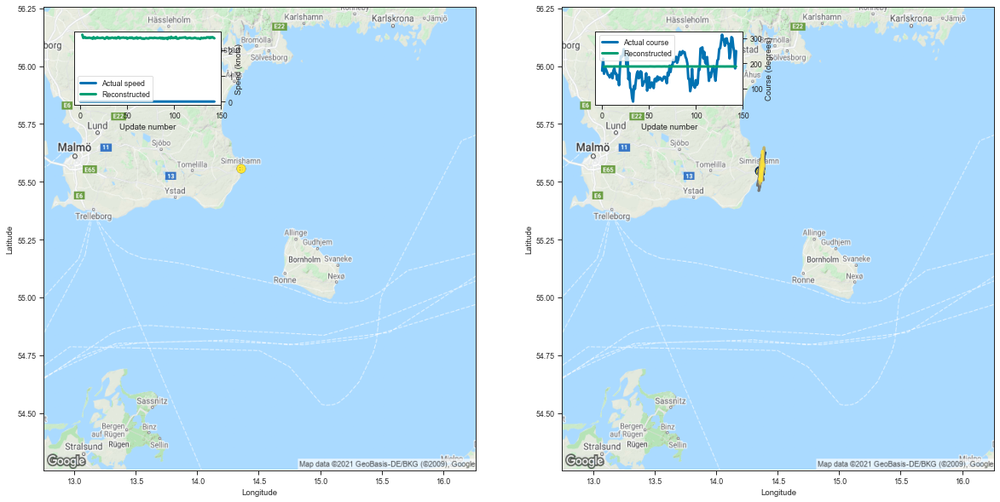

[2.624542474746704, 2.4957692623138428, 2.5072195529937744, 2.524599313735962]


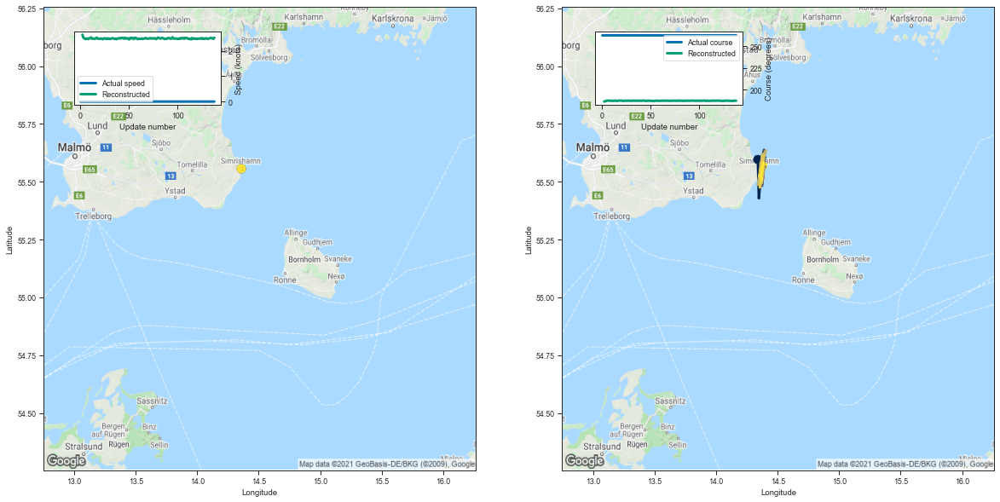

[2.6438868045806885, 2.52413010597229, 2.502375841140747, 2.470097780227661]


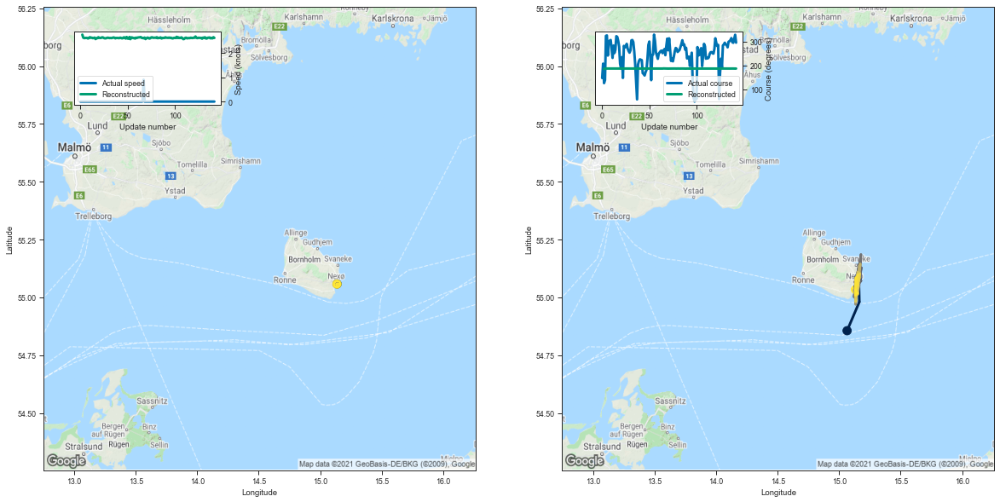

[2.7681386470794678, 2.6434853076934814, 2.624300241470337, 2.628481149673462]


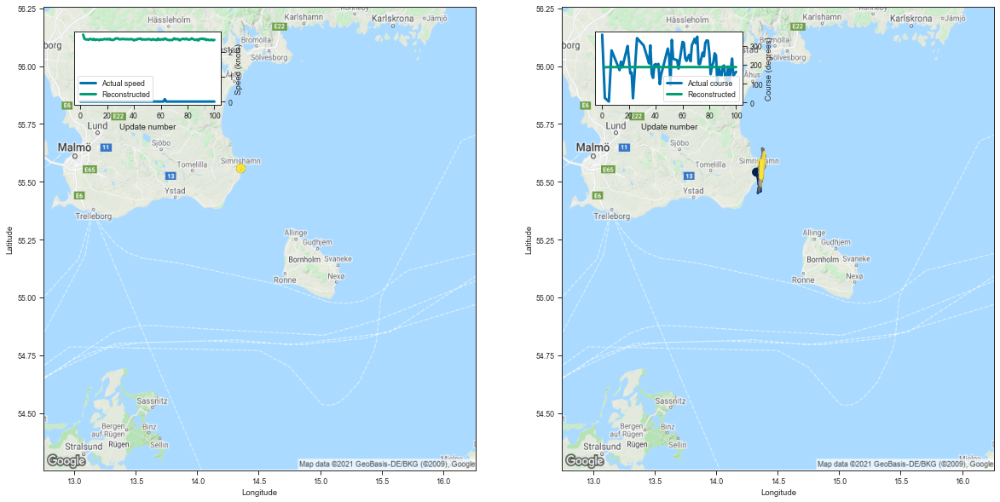

[2.6841514110565186, 2.5180904865264893, 2.4901058673858643, 2.4931304454803467]


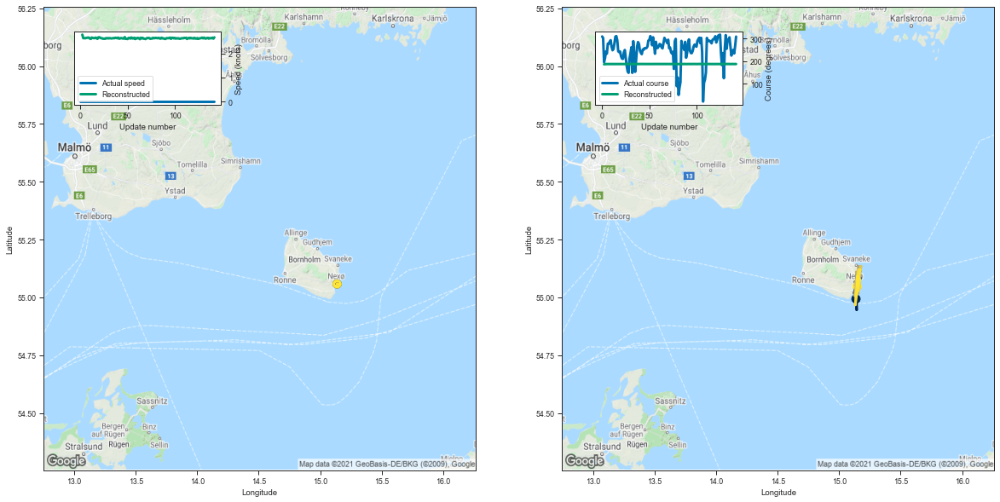

[2.7807648181915283, 2.632342576980591, 2.637948751449585, 2.629356622695923]


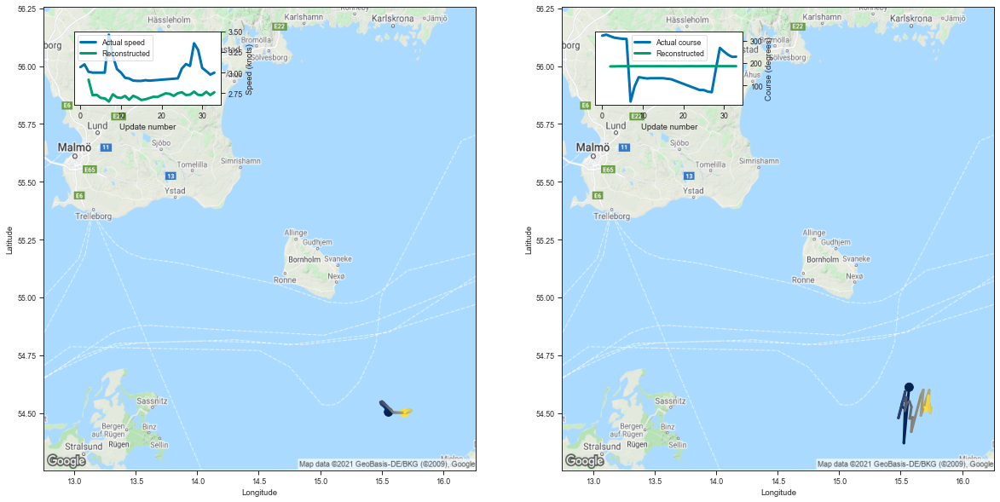

[2.9152534008026123, 2.7253663539886475, 2.7315757274627686, 2.694096803665161]


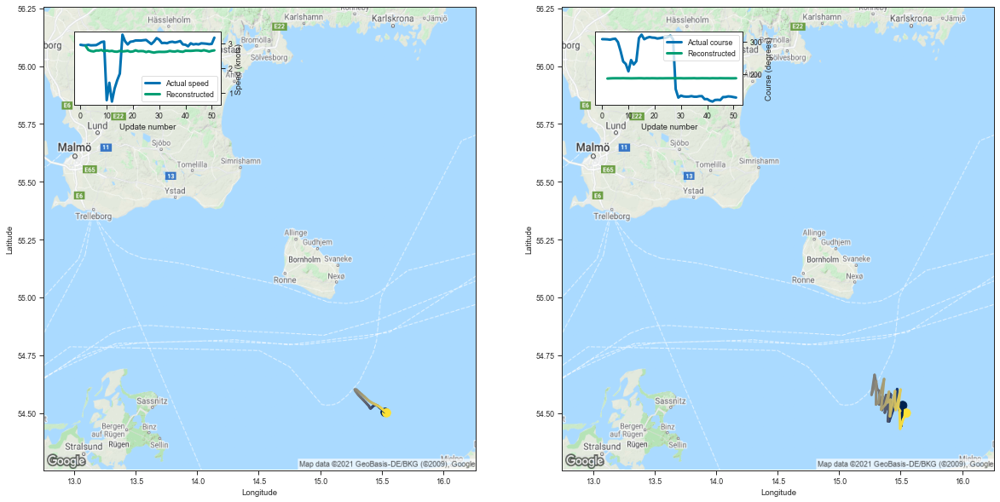

[2.885802984237671, 2.7277638912200928, 2.685467481613159, 2.66791033744812]


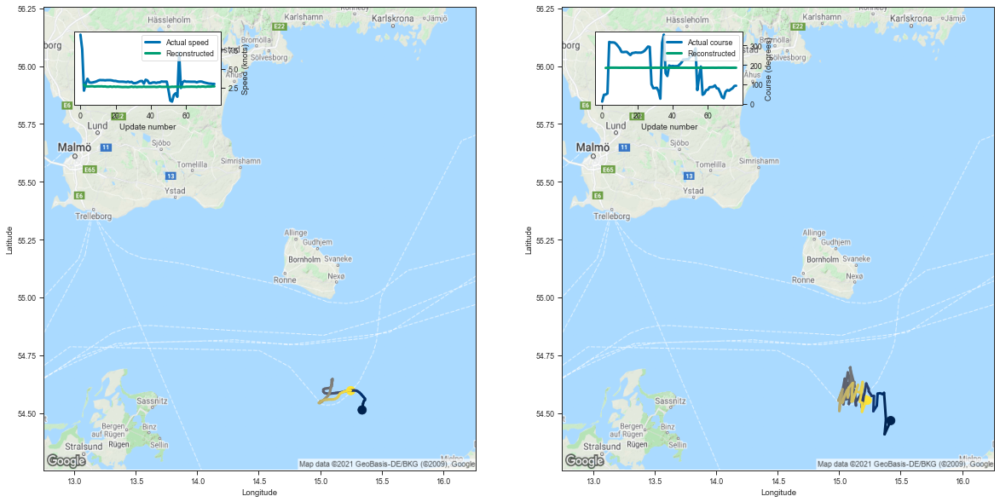

[2.8986775875091553, 2.67887282371521, 2.6760003566741943, 2.6712024211883545]


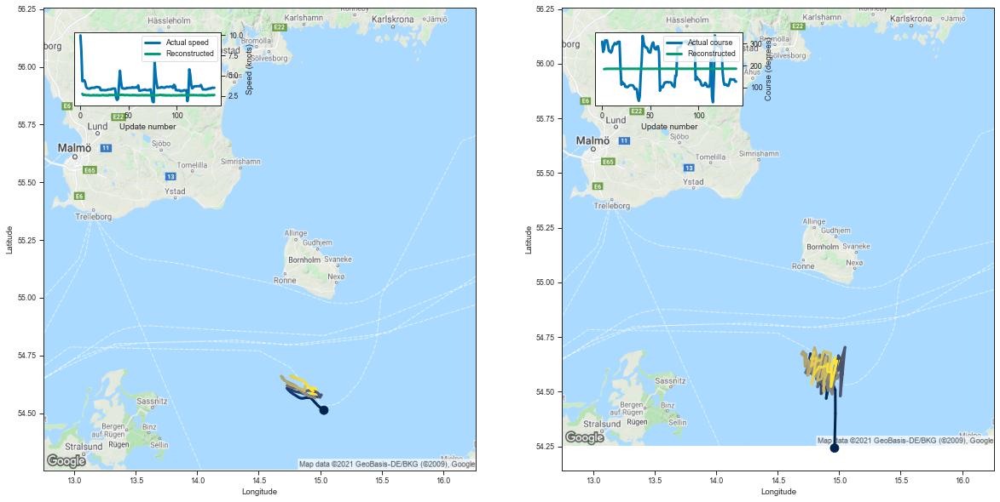

[2.751901865005493, 2.6066601276397705, 2.632948637008667, 2.6164557933807373]


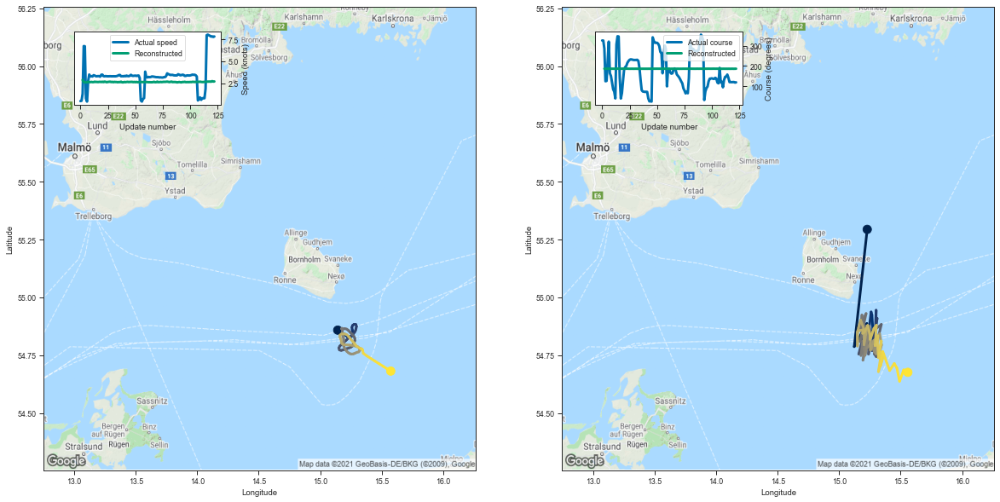

[2.8814032077789307, 2.6360561847686768, 2.6120240688323975, 2.622619390487671]


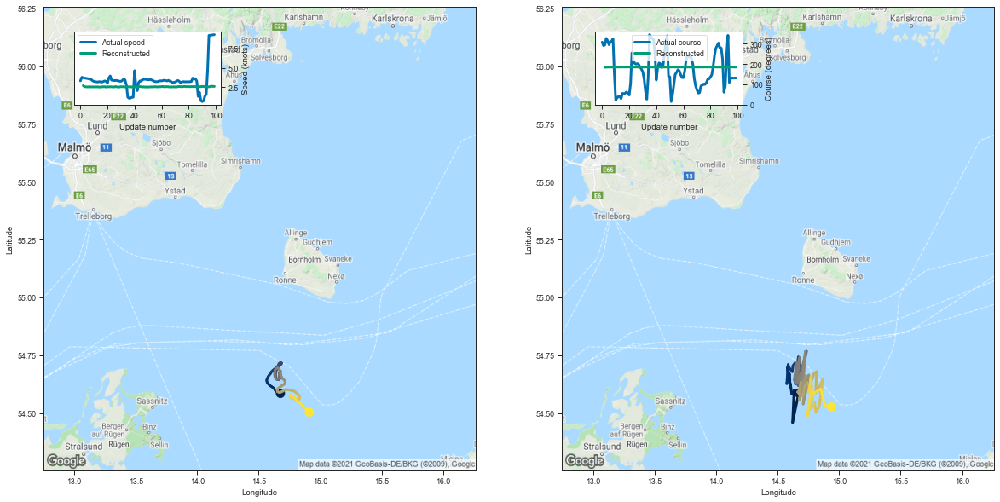

[2.708223581314087, 2.5653345584869385, 2.5517494678497314, 2.5344479084014893]


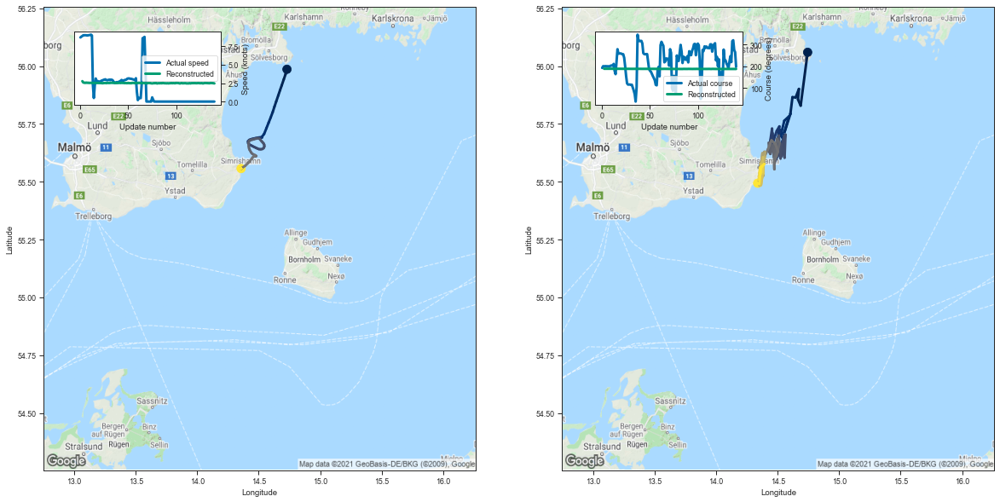

[2.765744924545288, 2.5786774158477783, 2.558769941329956, 2.532001256942749]


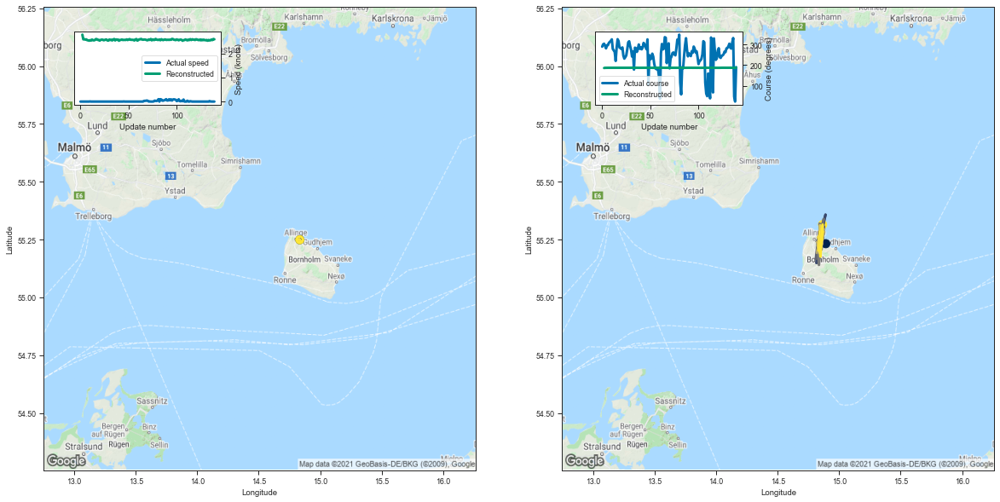

[2.790222406387329, 2.5918595790863037, 2.599890947341919, 2.5825517177581787]


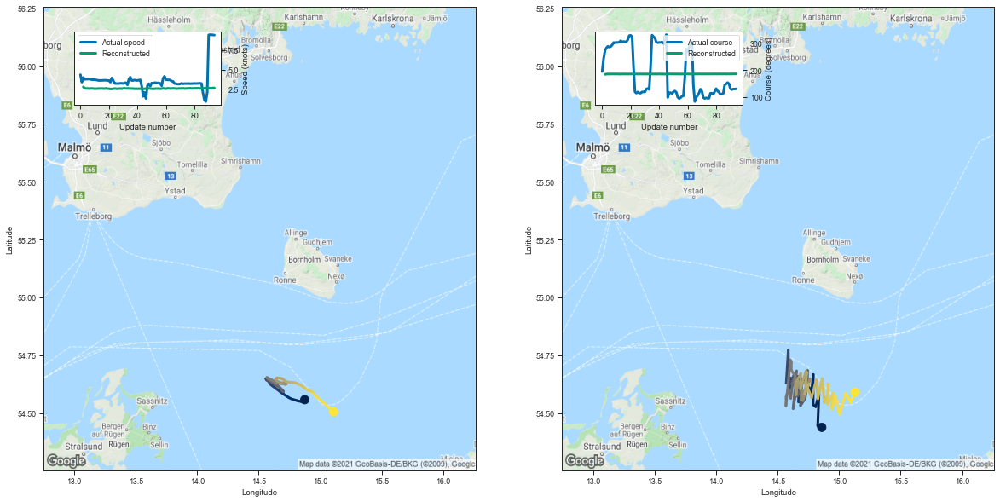

[2.7706191539764404, 2.6006581783294678, 2.5586659908294678, 2.57279896736145]


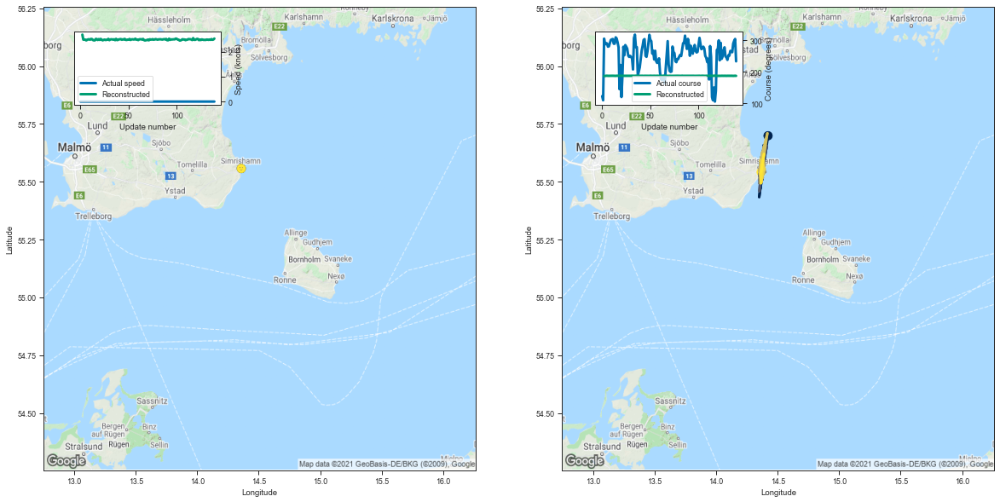

[2.692213773727417, 2.488814115524292, 2.493129014968872, 2.4885051250457764]


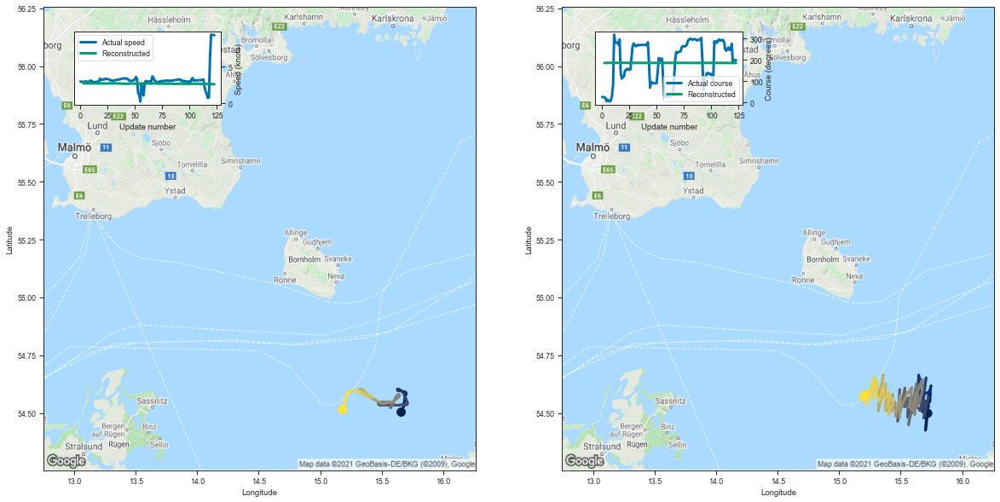

[2.926800012588501, 2.7452757358551025, 2.7312209606170654, 2.7491071224212646]


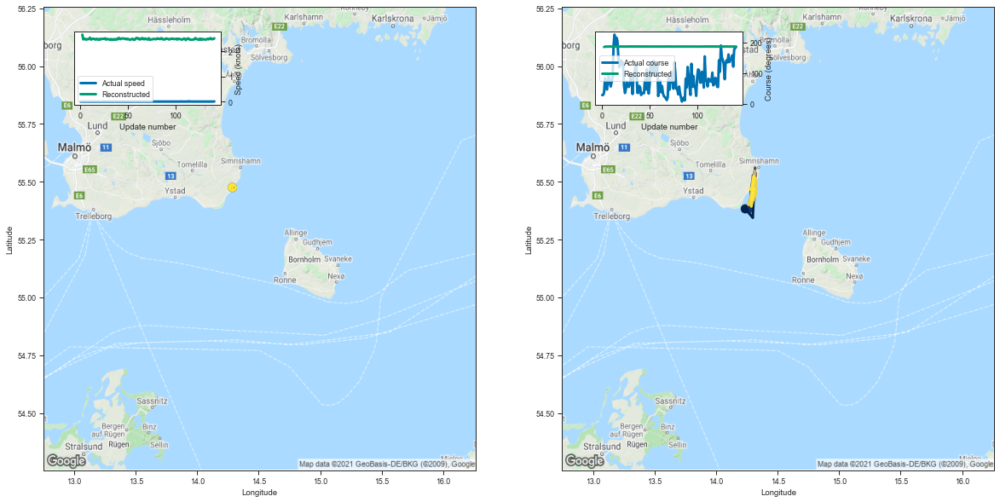

[2.657325506210327, 2.4673573970794678, 2.4869792461395264, 2.490168809890747]


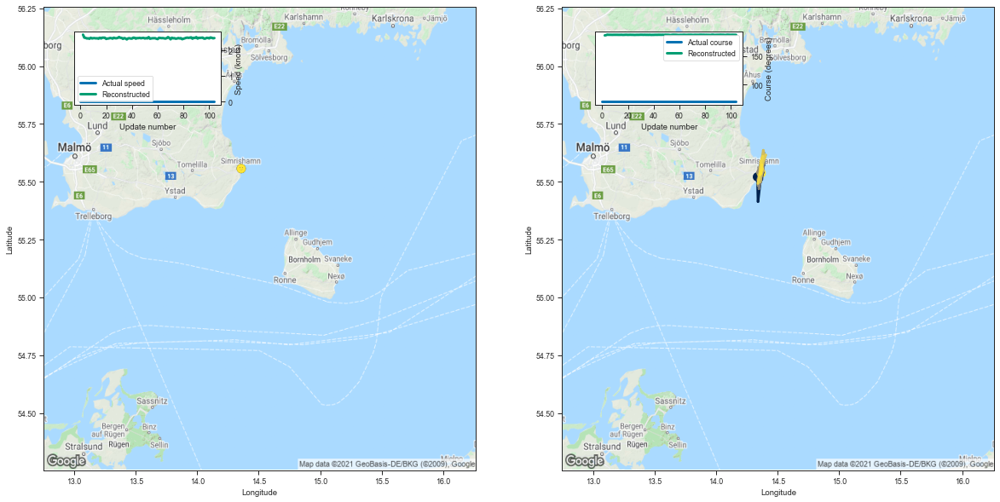

[2.628465414047241, 2.509626626968384, 2.501459836959839, 2.4780075550079346]


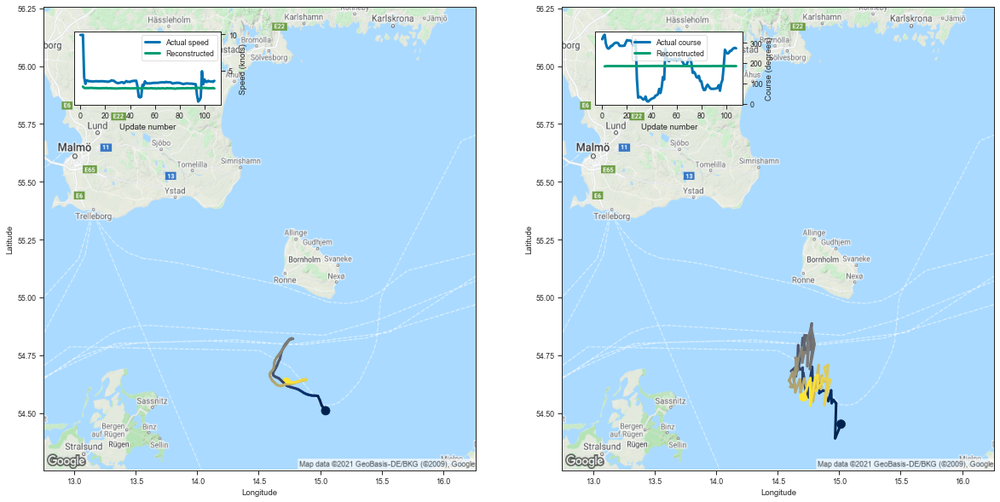

[2.780139684677124, 2.6162970066070557, 2.574434995651245, 2.6008870601654053]


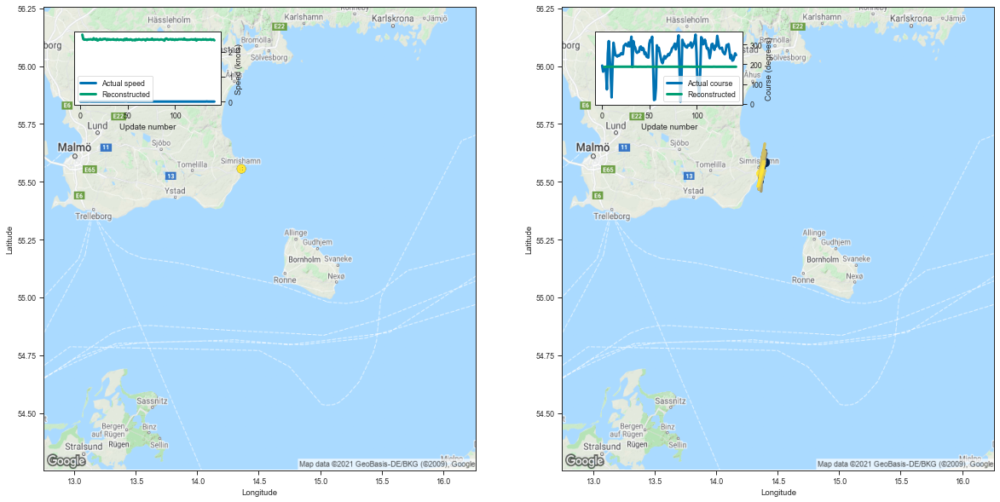

[2.690490484237671, 2.514310121536255, 2.4847209453582764, 2.498950242996216]


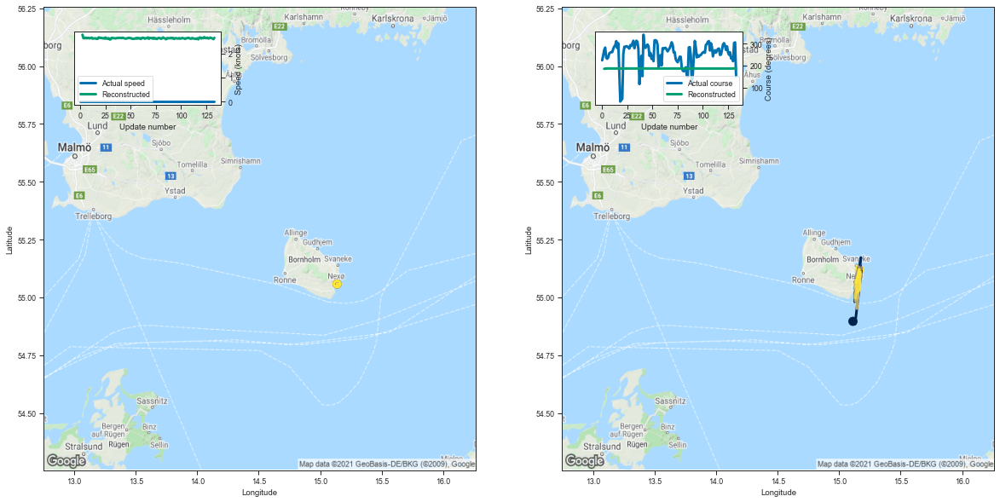

[2.7829673290252686, 2.6372482776641846, 2.6320221424102783, 2.657372236251831]


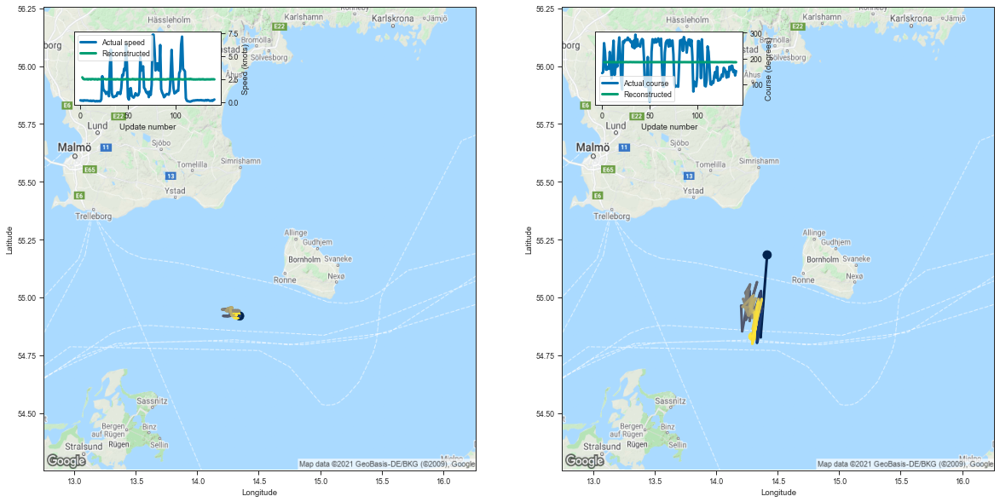

[2.697234869003296, 2.5281007289886475, 2.48000168800354, 2.490544557571411]


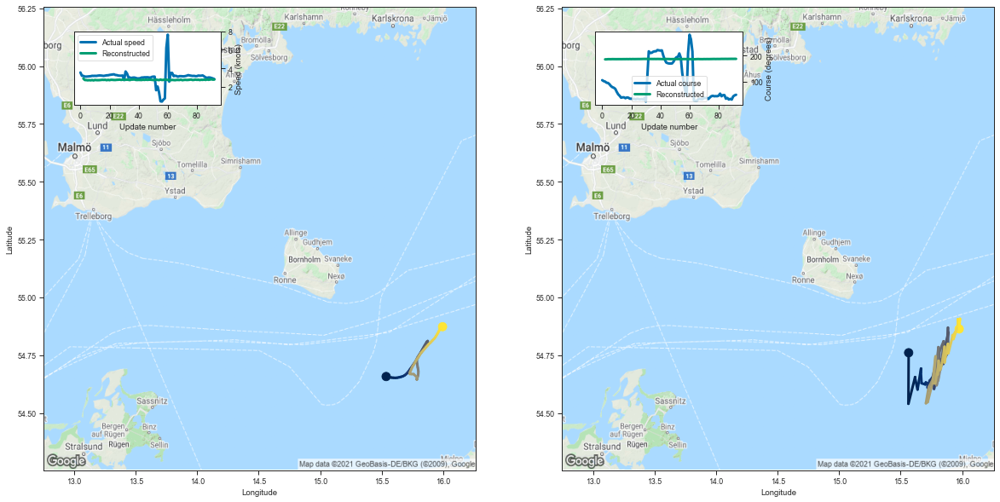

[2.8946330547332764, 2.7326138019561768, 2.7285349369049072, 2.701517343521118]


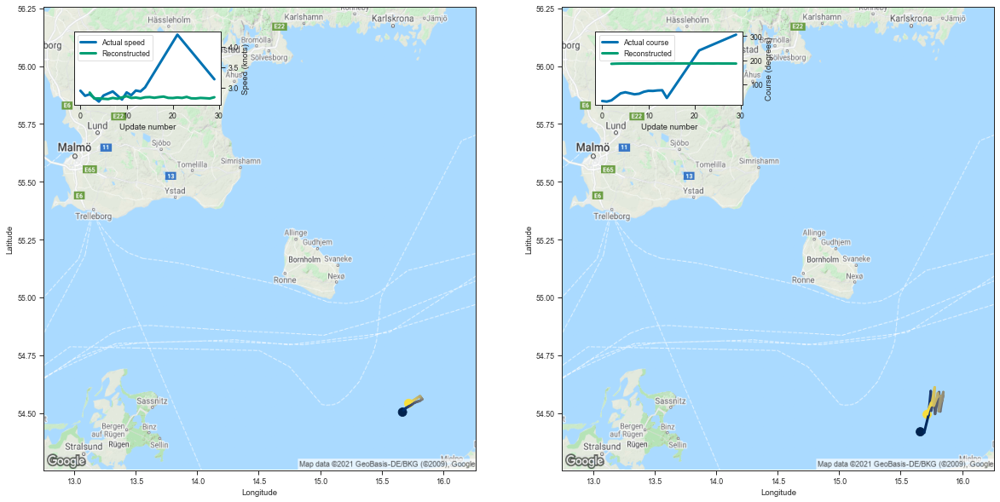

[2.8726141452789307, 2.7246592044830322, 2.728299379348755, 2.719090223312378]


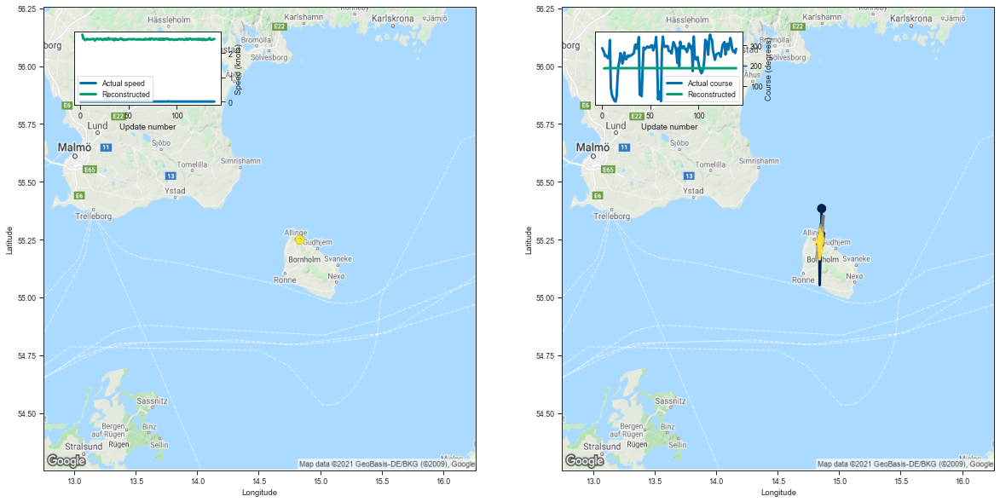

[2.771293878555298, 2.602496385574341, 2.591404676437378, 2.5408990383148193]


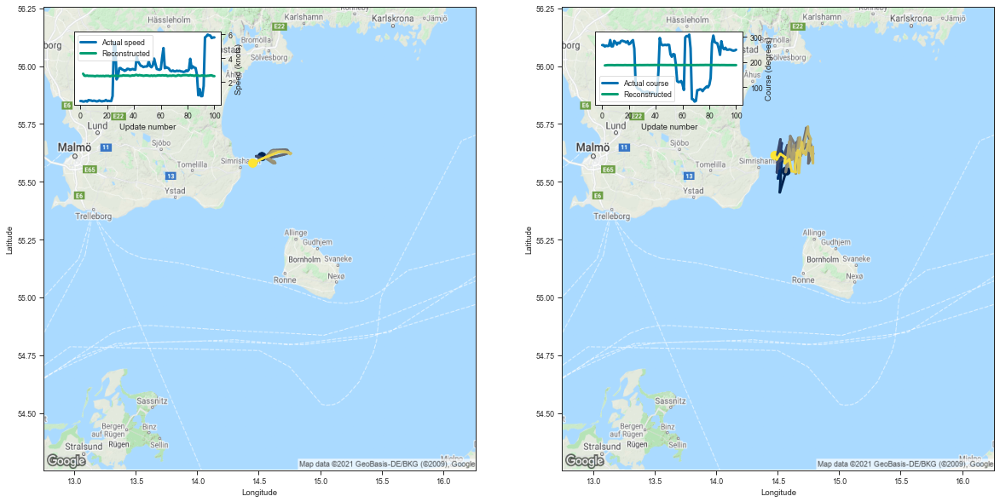

[2.700650453567505, 2.5338895320892334, 2.5250051021575928, 2.54701828956604]


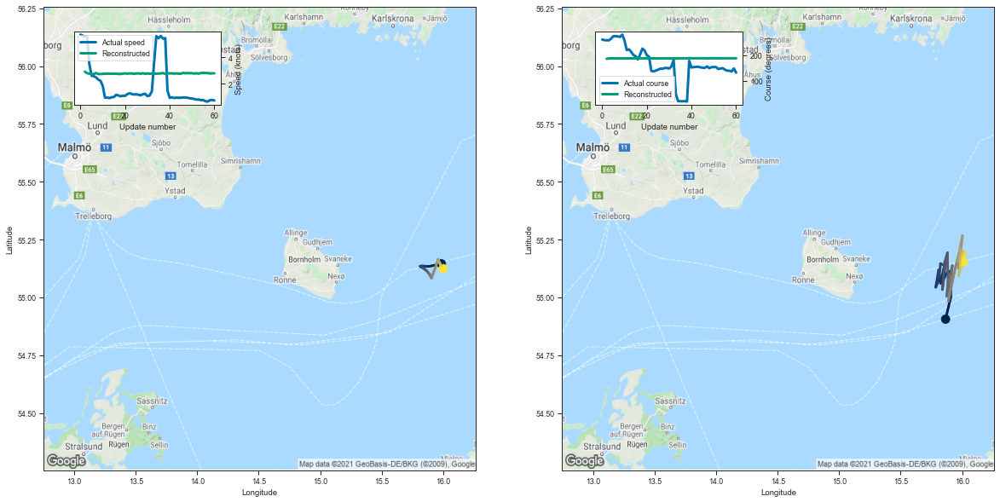

[2.9134209156036377, 2.7968132495880127, 2.766585111618042, 2.7453835010528564]


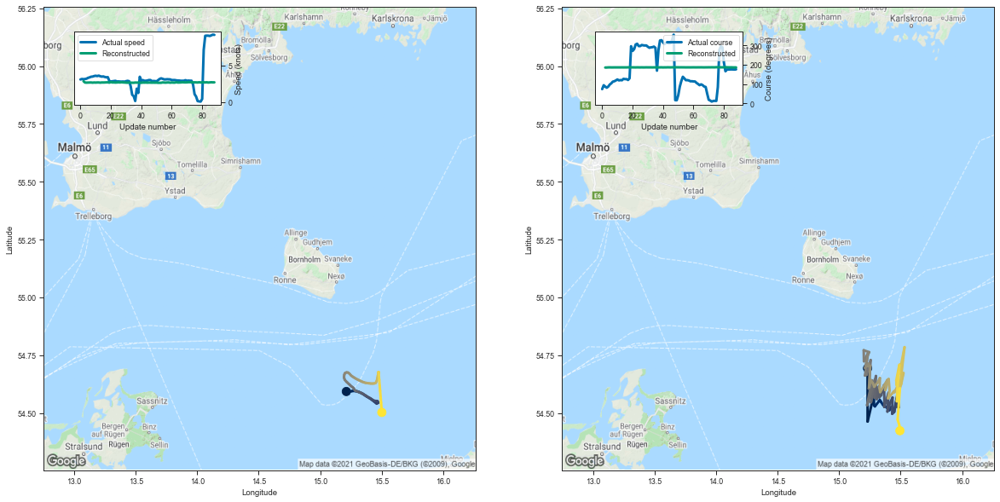

[2.843949556350708, 2.6611297130584717, 2.6464760303497314, 2.657127618789673]


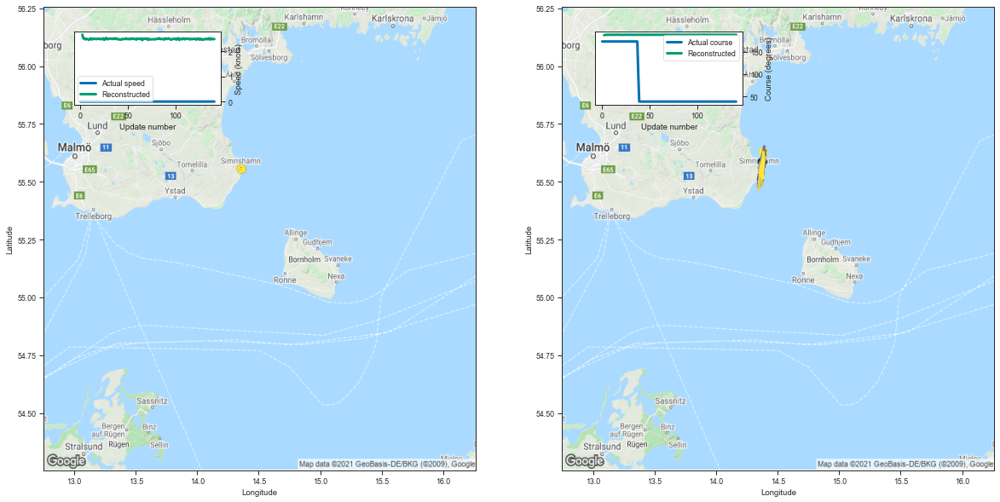

[2.669469118118286, 2.526127576828003, 2.5128777027130127, 2.476834535598755]


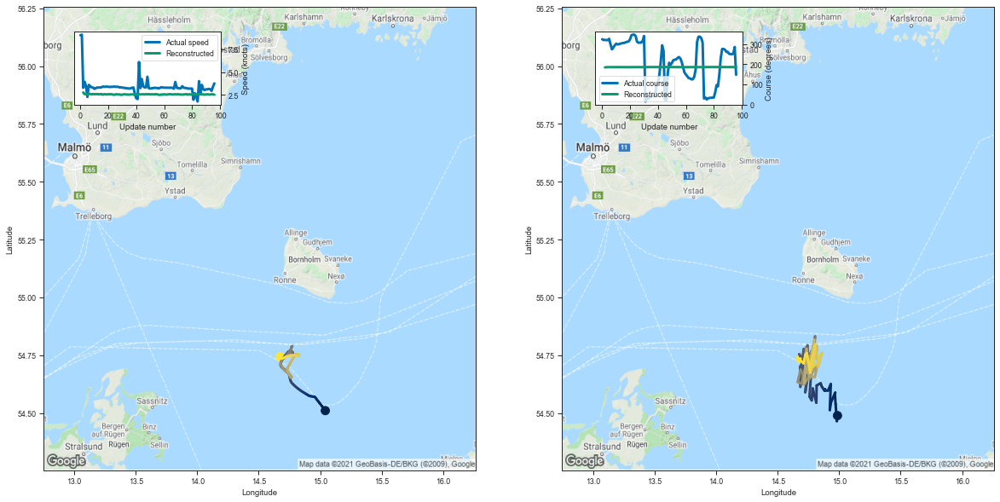

[2.7745912075042725, 2.5979793071746826, 2.5906436443328857, 2.601297616958618]


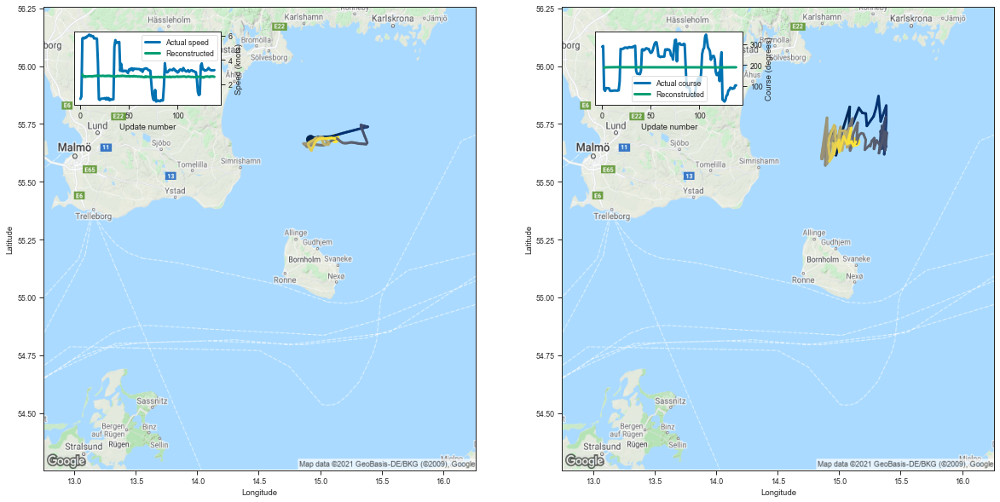

[2.8002073764801025, 2.609022378921509, 2.6545612812042236, 2.595586061477661]


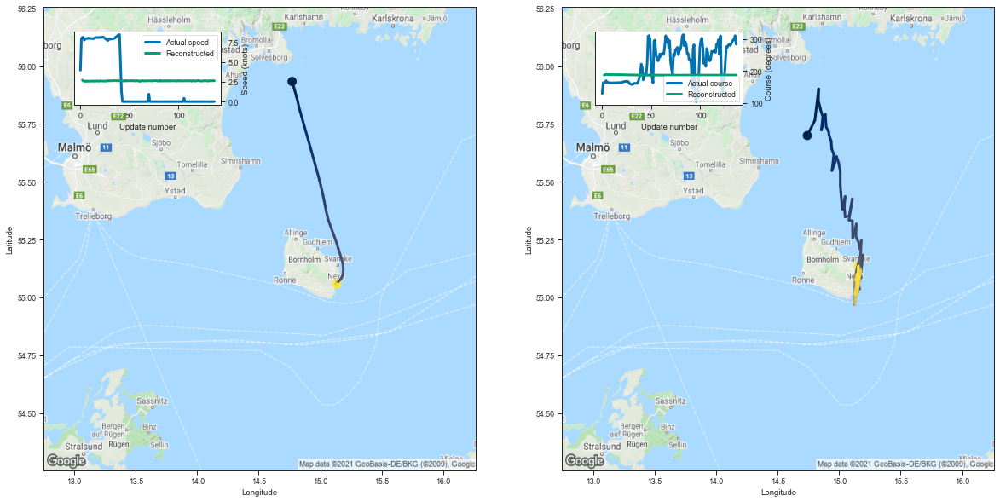

[2.721862554550171, 2.5969645977020264, 2.5962541103363037, 2.564526319503784]


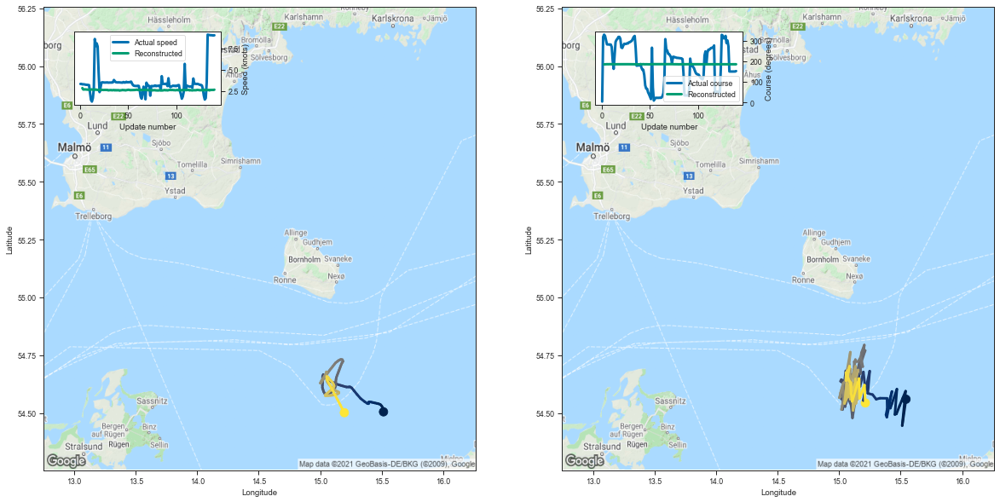

[2.863166093826294, 2.6937005519866943, 2.7031261920928955, 2.706732988357544]


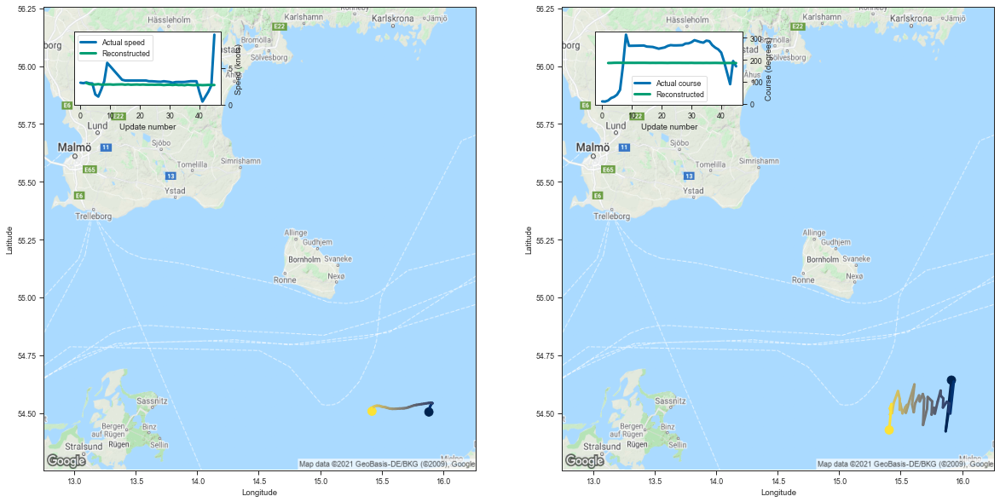

[2.9671590328216553, 2.8097317218780518, 2.759889841079712, 2.7622182369232178]


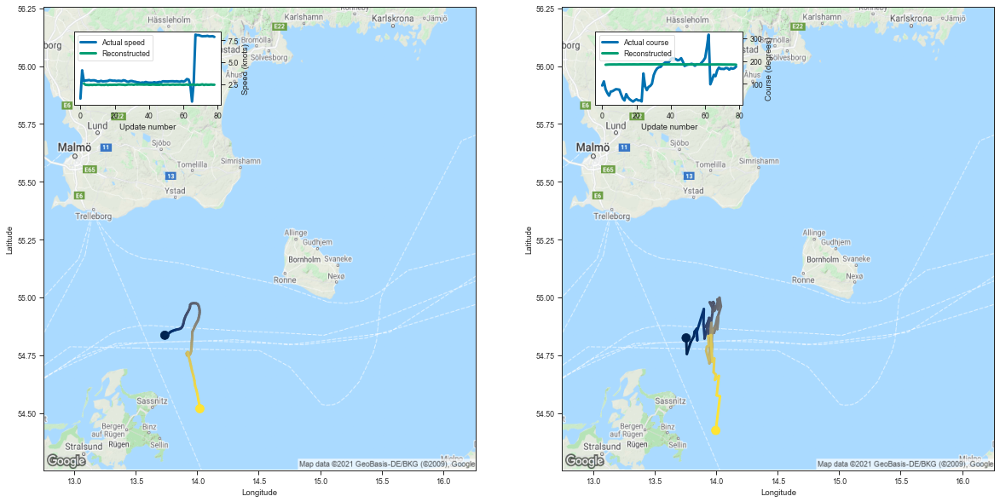

[2.5577023029327393, 2.41119647026062, 2.4014670848846436, 2.390180826187134]


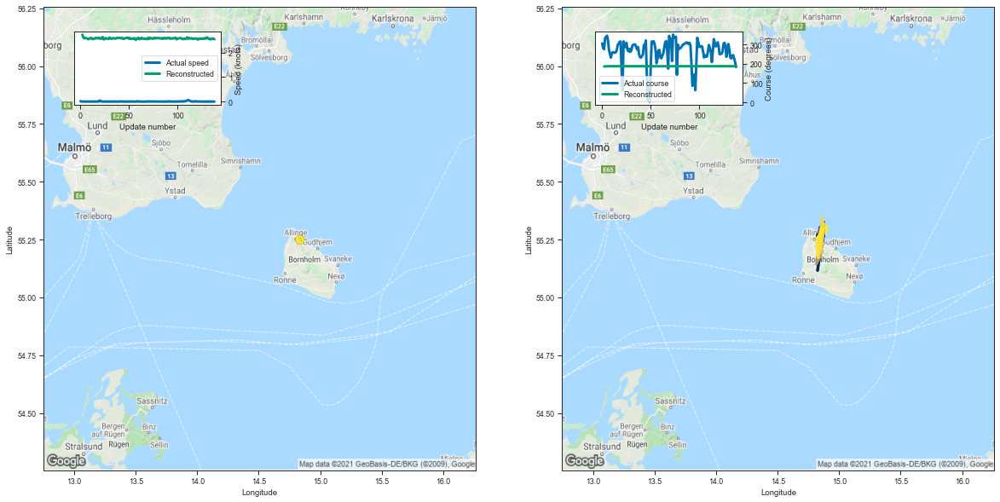

[2.7334611415863037, 2.6124298572540283, 2.5829012393951416, 2.5964910984039307]


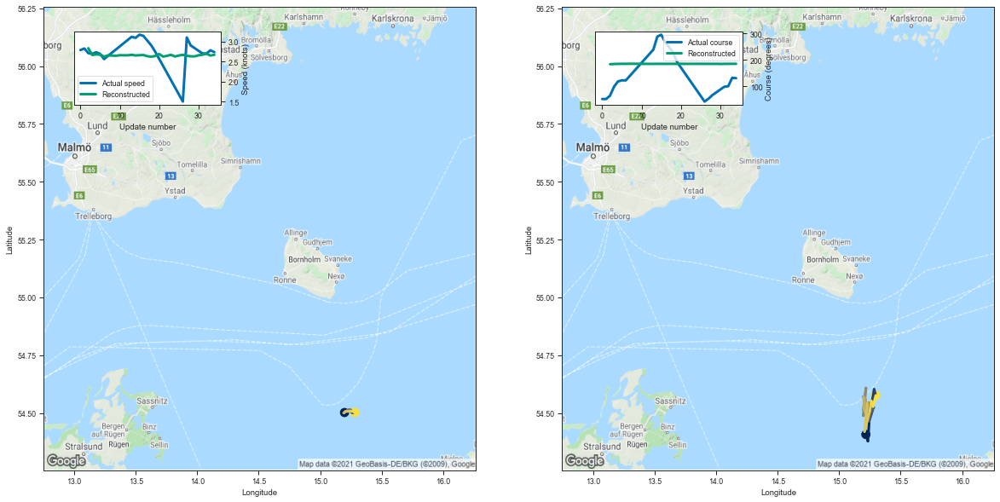

[2.8324081897735596, 2.6624796390533447, 2.6774747371673584, 2.6680386066436768]


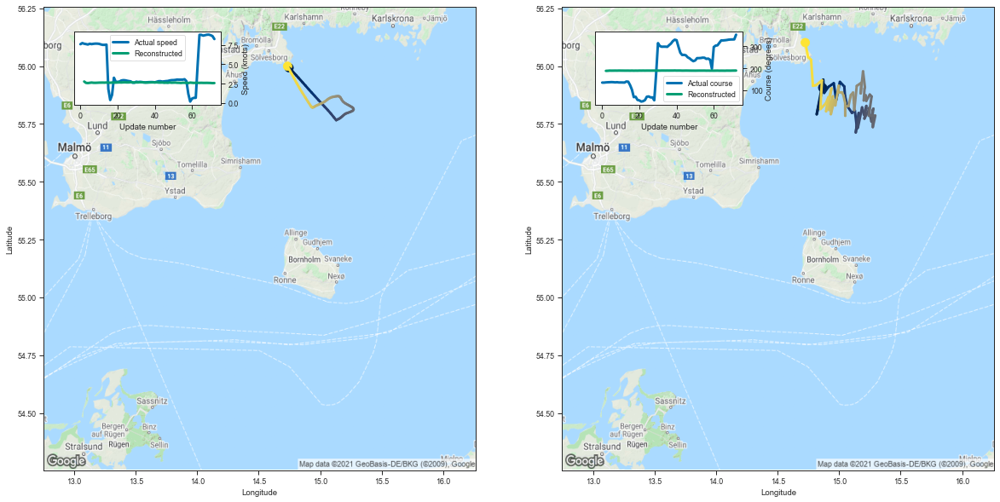

[2.7674167156219482, 2.5932180881500244, 2.566856622695923, 2.6021993160247803]


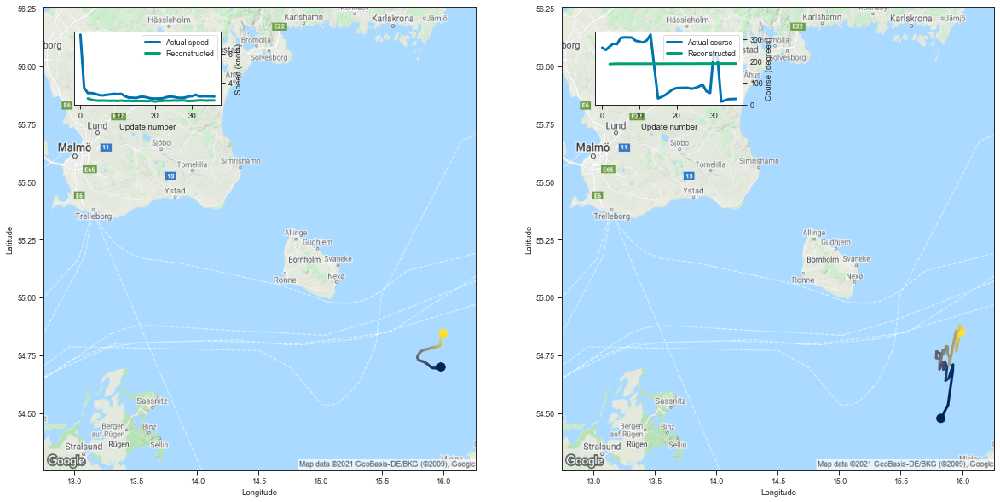

[2.9135425090789795, 2.8267805576324463, 2.7828142642974854, 2.765119791030884]


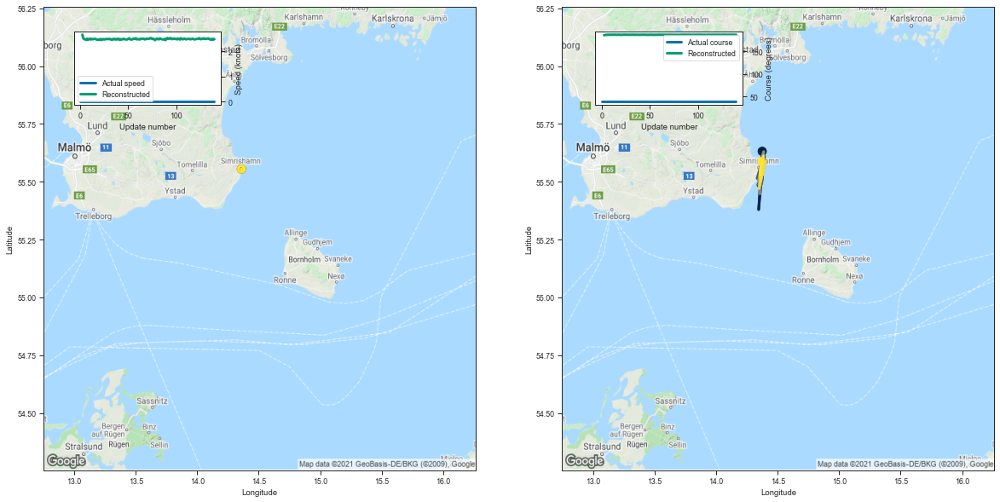

[2.670959234237671, 2.5254299640655518, 2.4922168254852295, 2.478235960006714]


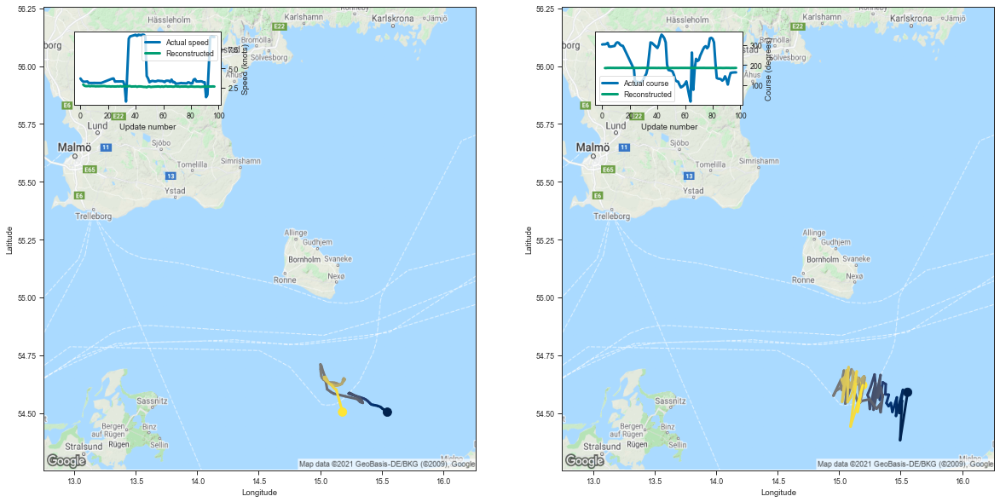

[2.8908402919769287, 2.7313015460968018, 2.690485715866089, 2.6927735805511475]


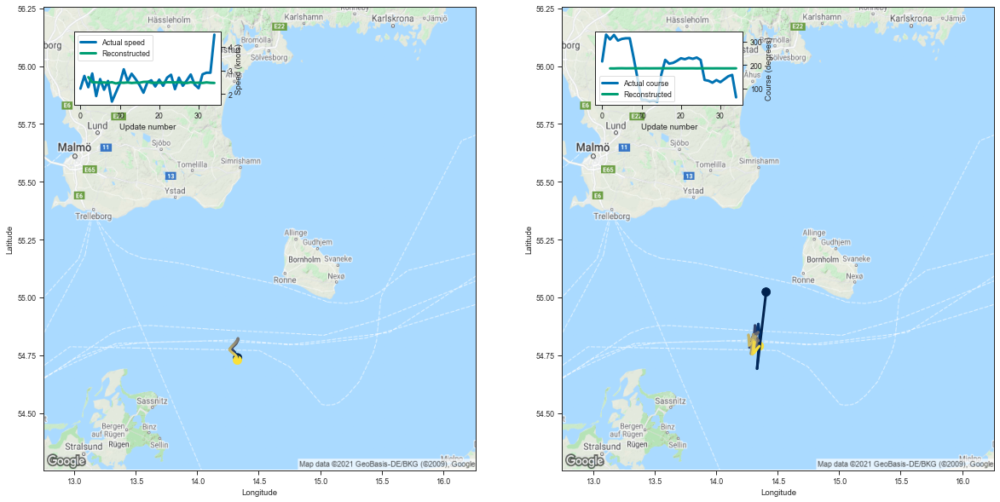

[2.7127130031585693, 2.500537633895874, 2.4935238361358643, 2.4830167293548584]


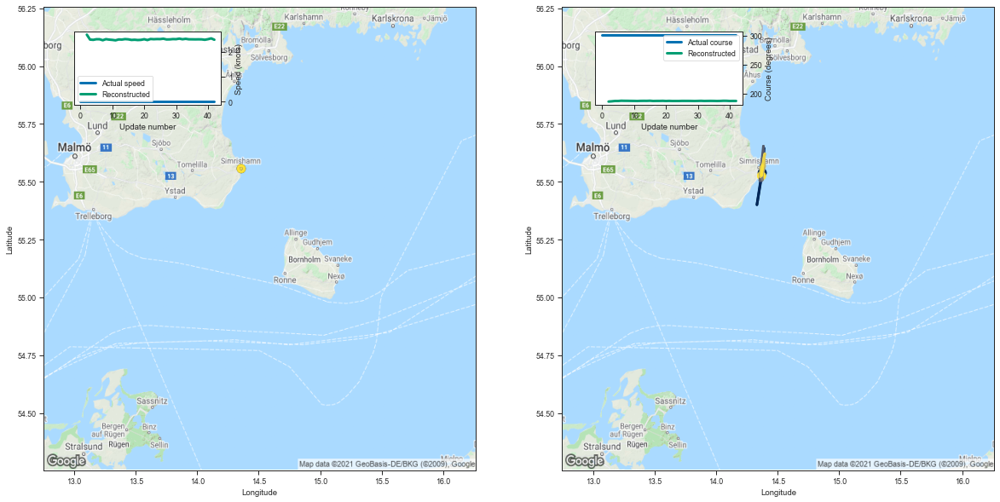

[2.6811745166778564, 2.483982801437378, 2.472377061843872, 2.4966461658477783]


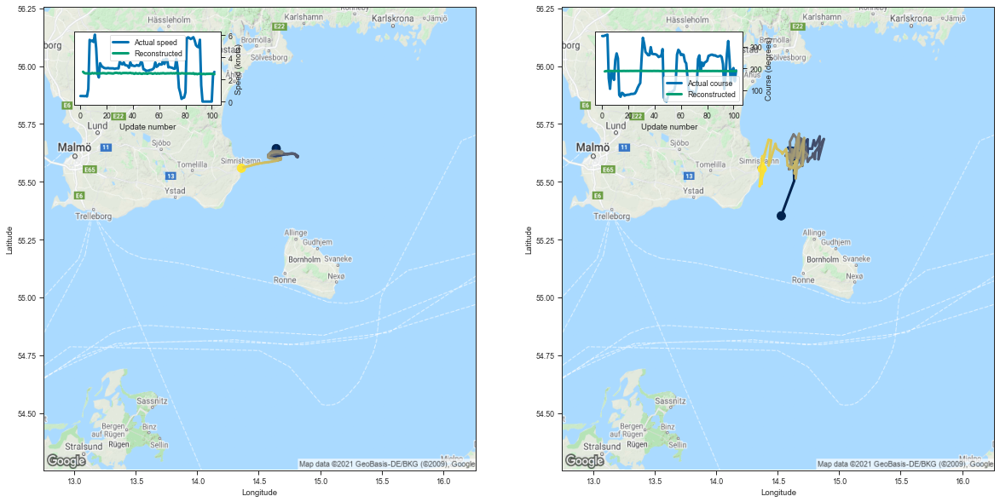

[2.691235303878784, 2.5719192028045654, 2.5431768894195557, 2.5493252277374268]


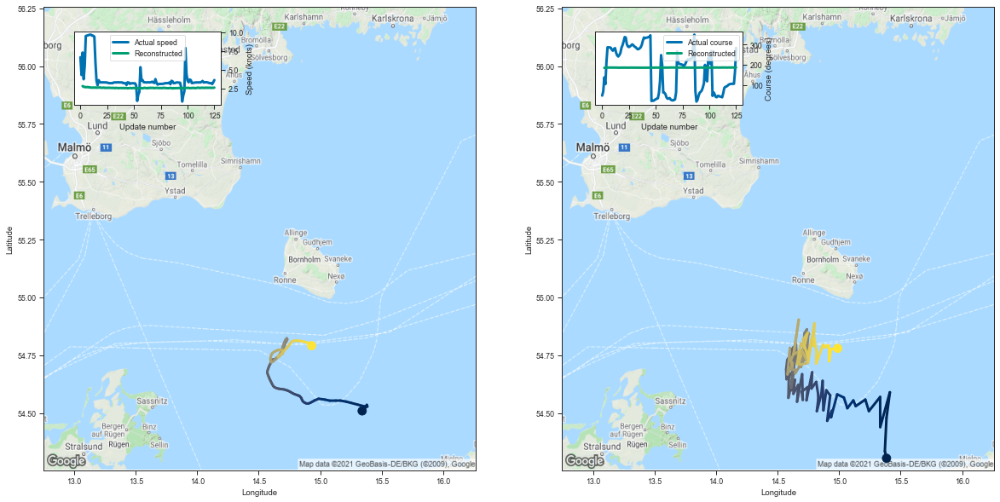

[2.812554121017456, 2.69832444190979, 2.704730749130249, 2.6533539295196533]


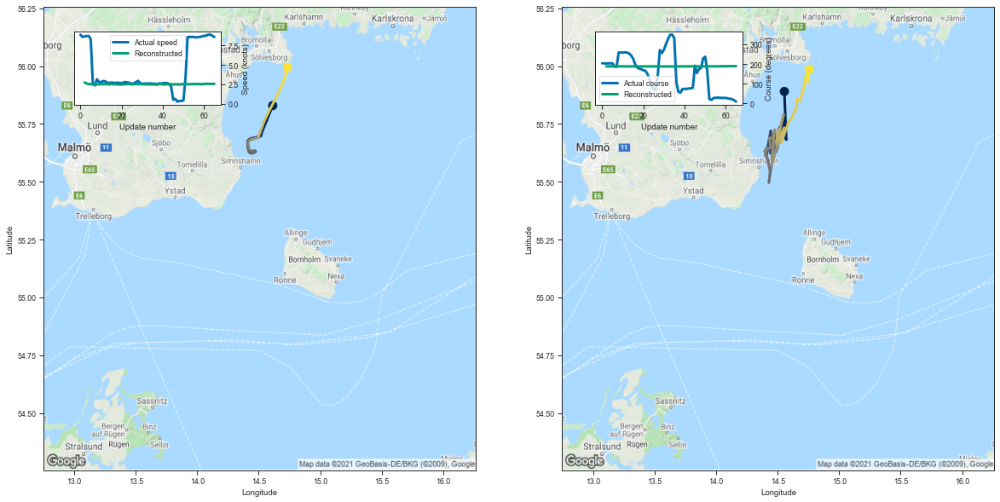

[2.746910810470581, 2.5960919857025146, 2.5446412563323975, 2.5156514644622803]


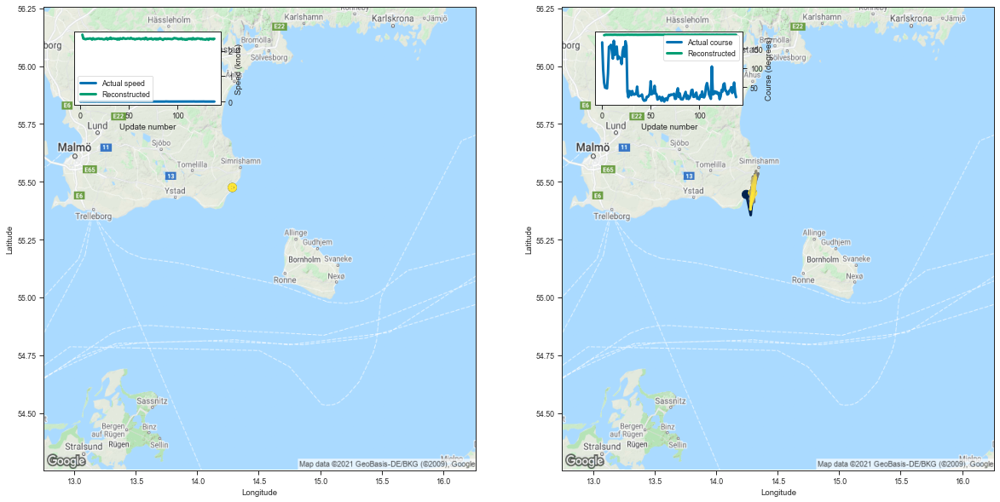

[2.6467134952545166, 2.4886863231658936, 2.482210397720337, 2.4642508029937744]


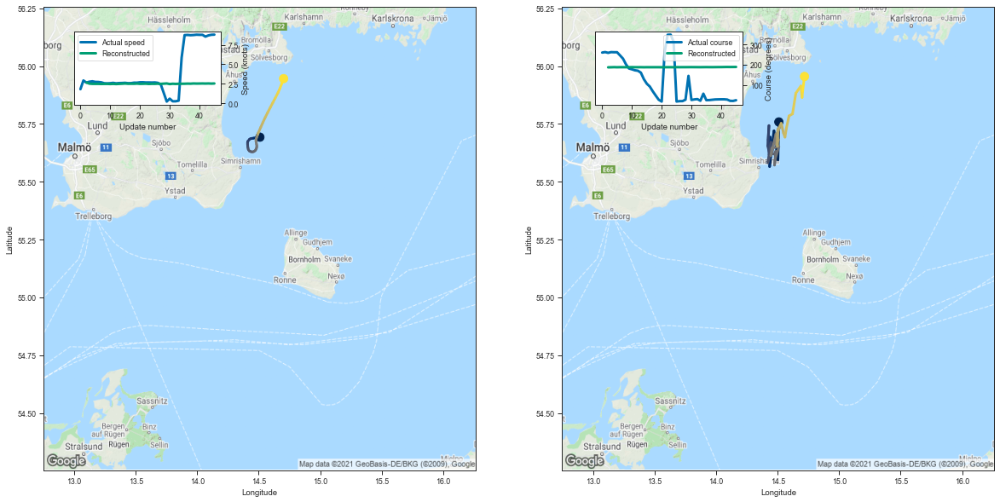

[2.686272382736206, 2.5347354412078857, 2.505824327468872, 2.504079580307007]


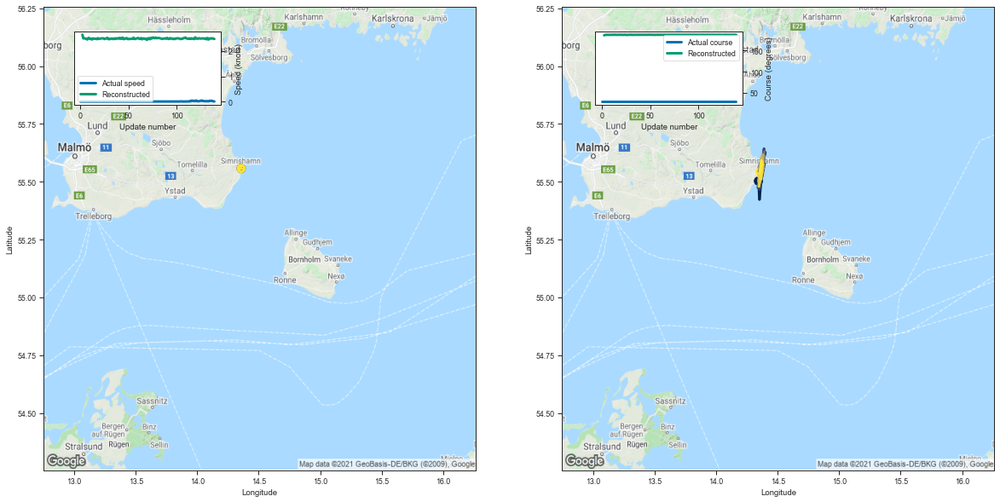

[2.647442102432251, 2.4985902309417725, 2.5025017261505127, 2.491358995437622]


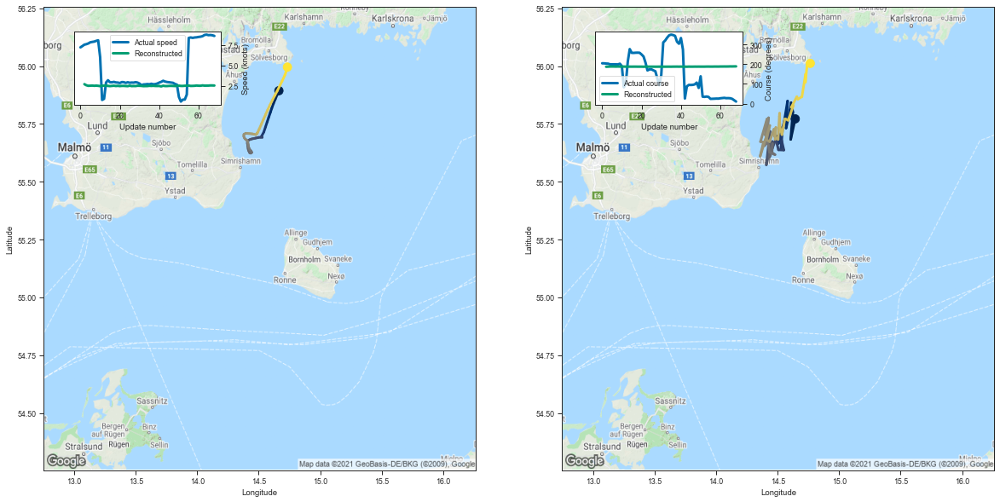

[2.723440408706665, 2.5873401165008545, 2.520733594894409, 2.5346810817718506]


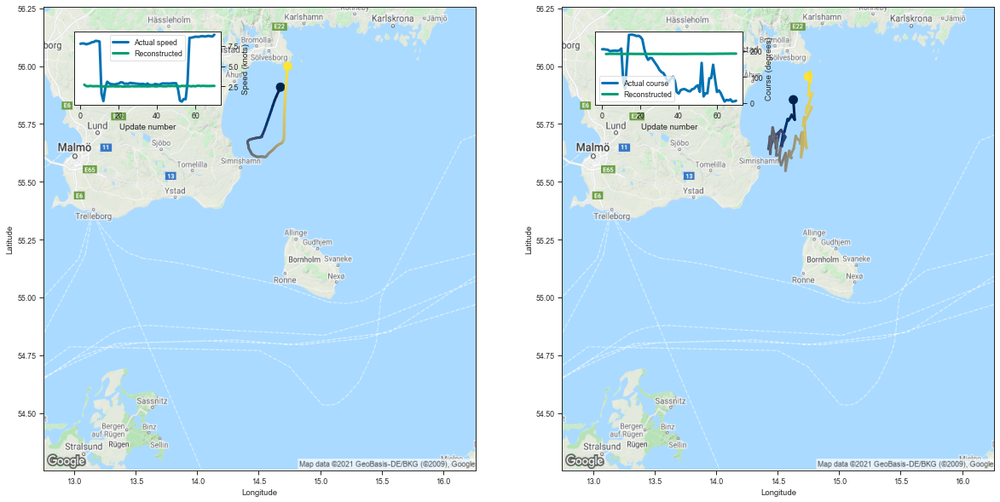

[2.721994161605835, 2.5552685260772705, 2.52483868598938, 2.5698606967926025]


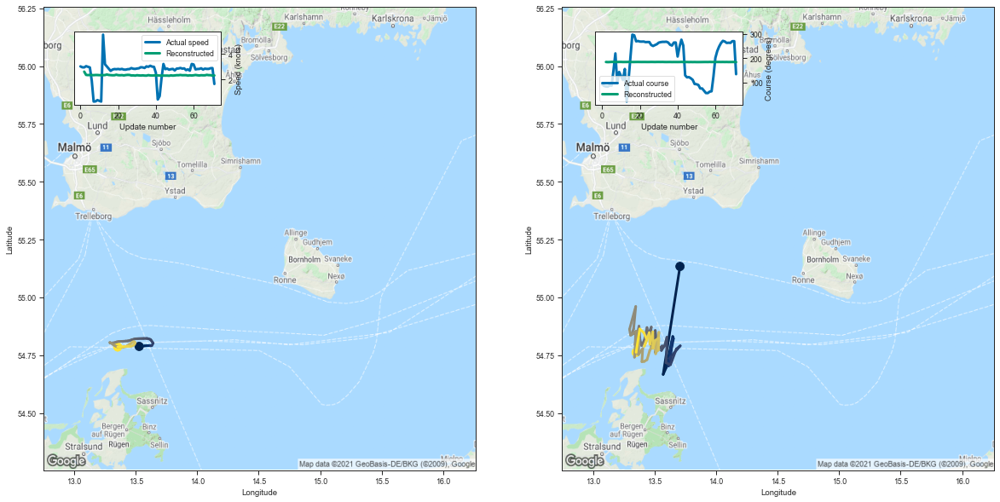

[2.624955892562866, 2.3711750507354736, 2.3561675548553467, 2.3689844608306885]


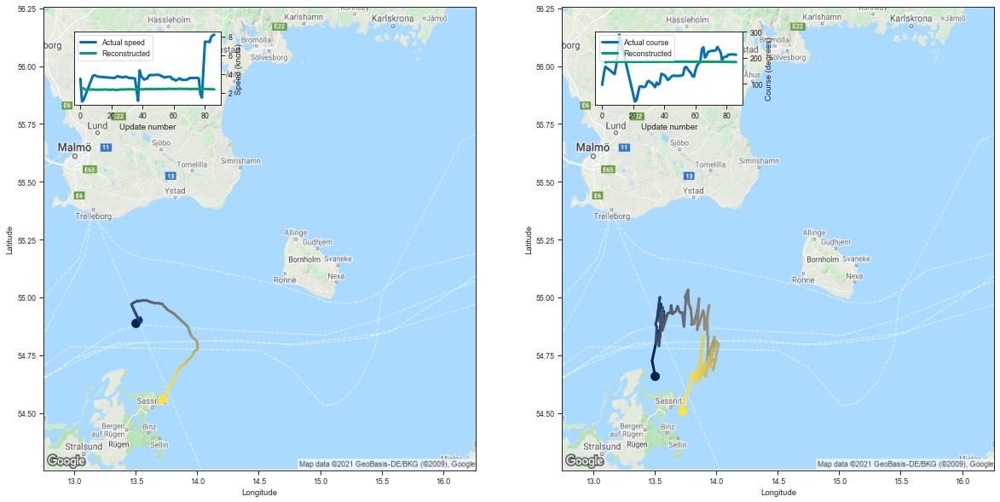

[2.5053093433380127, 2.344261884689331, 2.3445050716400146, 2.3733880519866943]


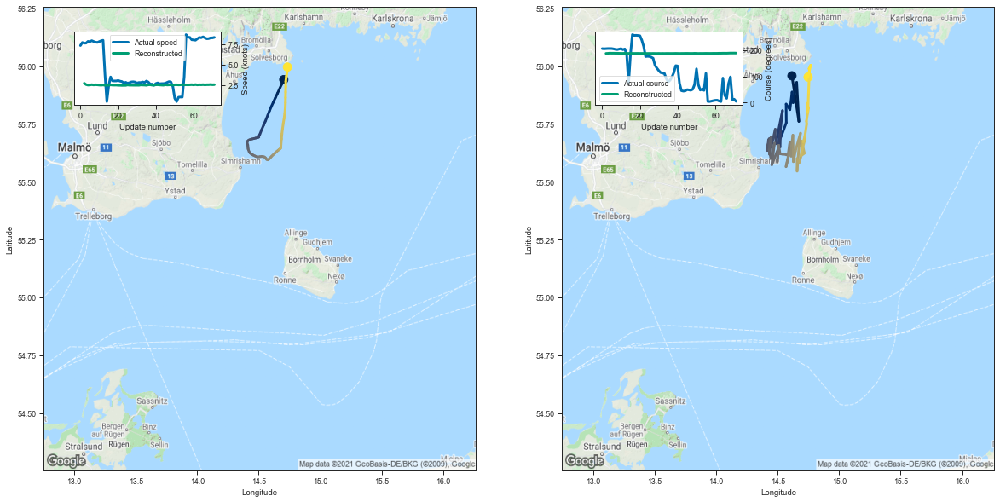

[2.7414000034332275, 2.5741727352142334, 2.5131733417510986, 2.530301332473755]


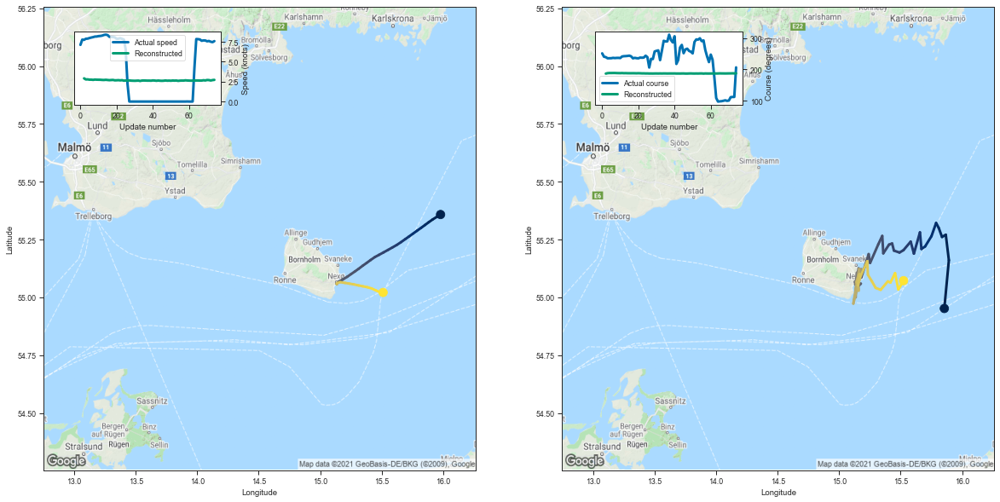

[2.9120914936065674, 2.774916410446167, 2.784515142440796, 2.746779203414917]


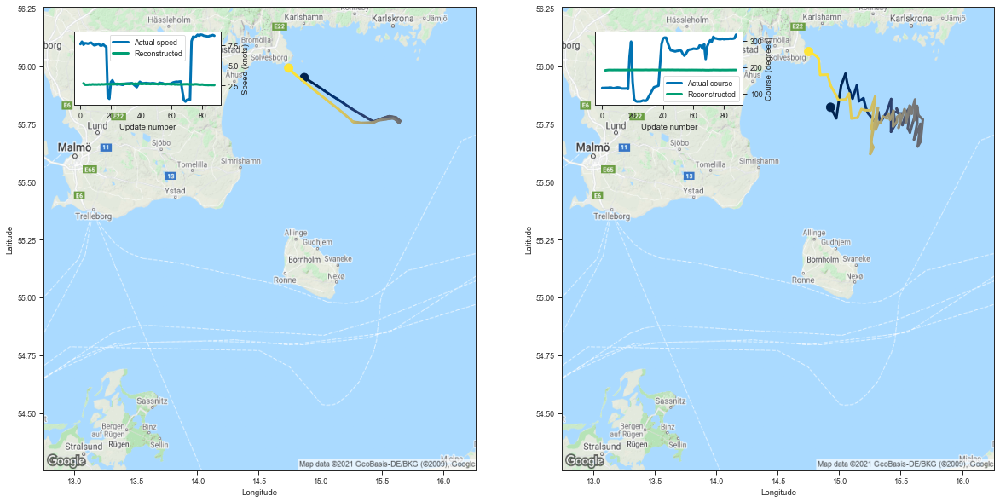

[2.7898032665252686, 2.6051137447357178, 2.6069586277008057, 2.611503839492798]


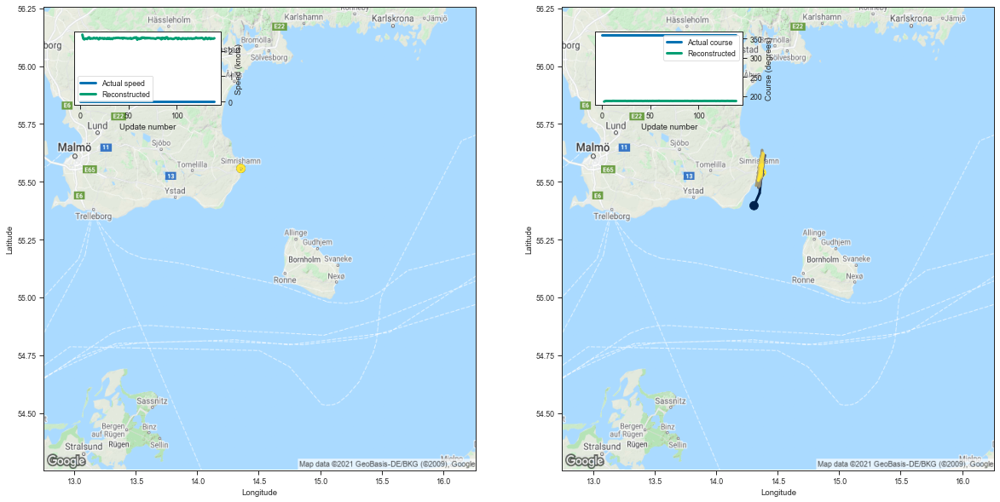

[2.6404502391815186, 2.480741262435913, 2.452613115310669, 2.481898546218872]


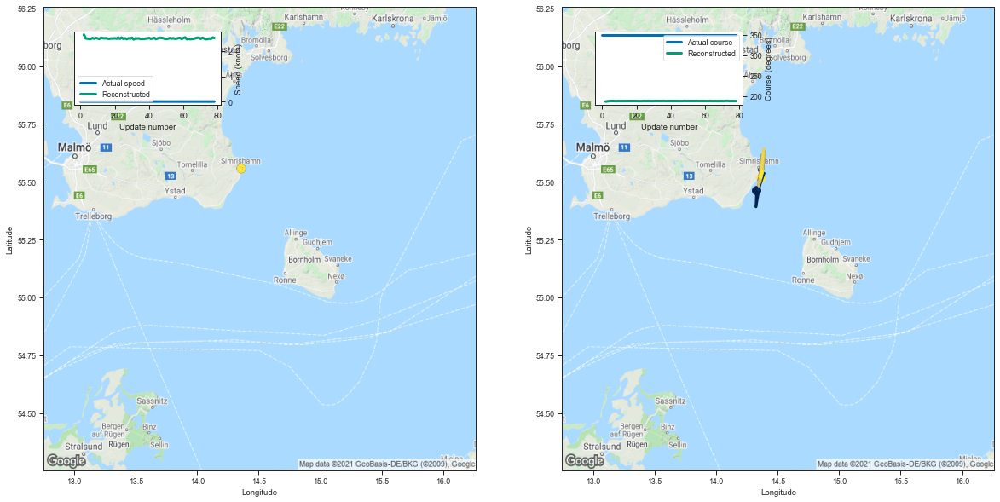

[2.6484482288360596, 2.507131814956665, 2.4923183917999268, 2.485313653945923]


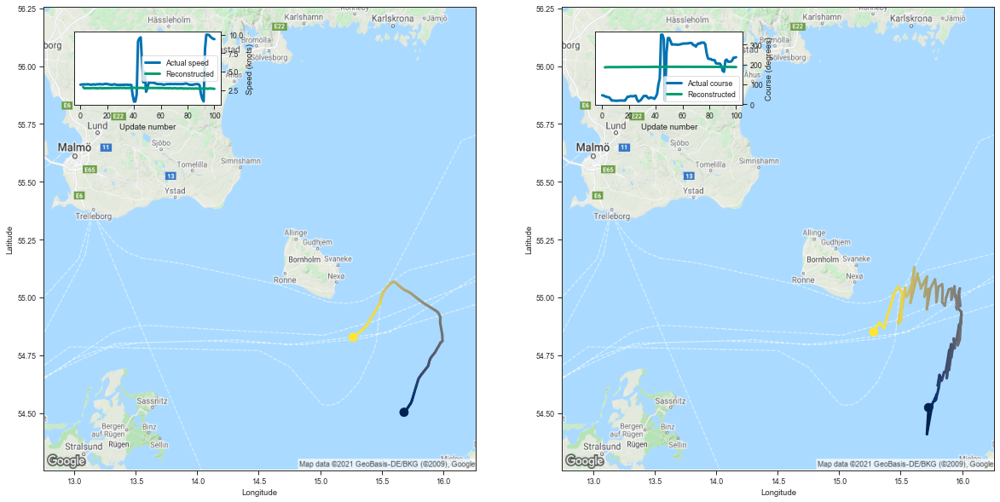

[2.896075963973999, 2.7242043018341064, 2.7363927364349365, 2.7501165866851807]


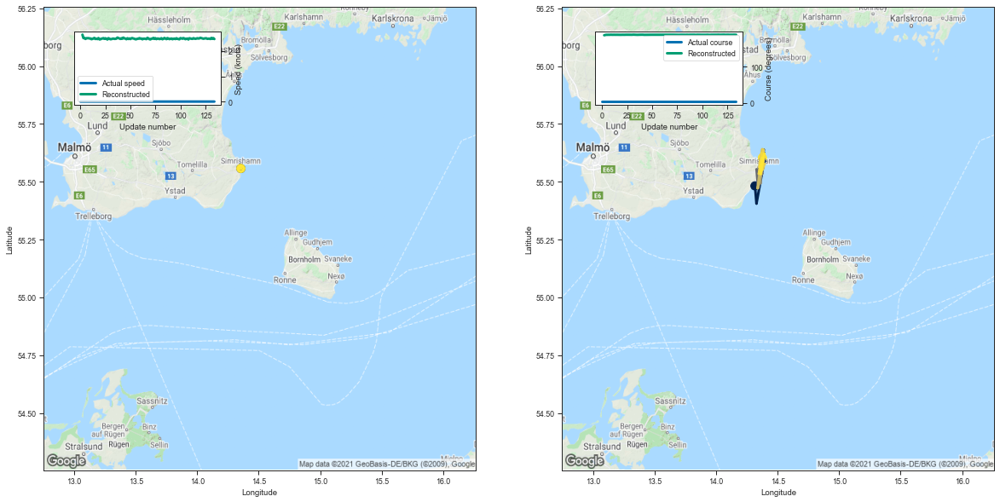

[2.652594804763794, 2.5152266025543213, 2.519381284713745, 2.4820640087127686]


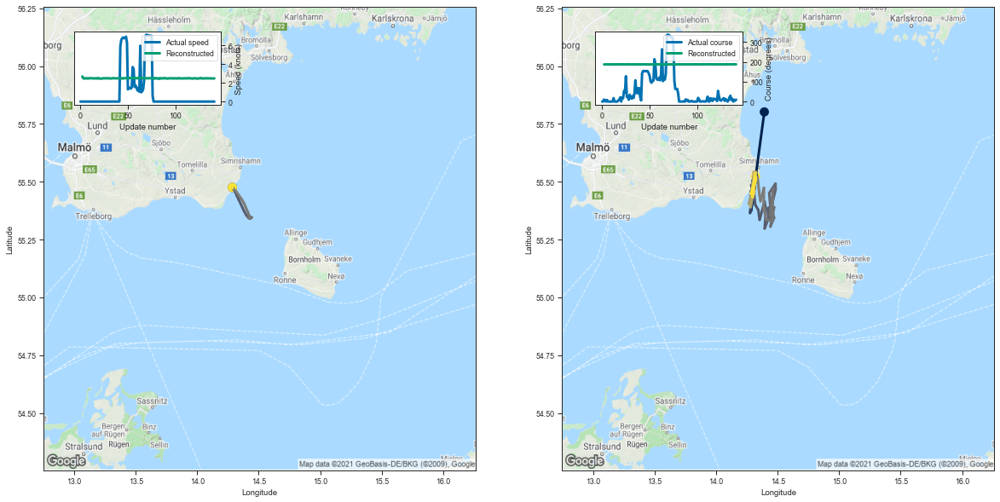

[2.6835362911224365, 2.48786997795105, 2.4781076908111572, 2.456080198287964]


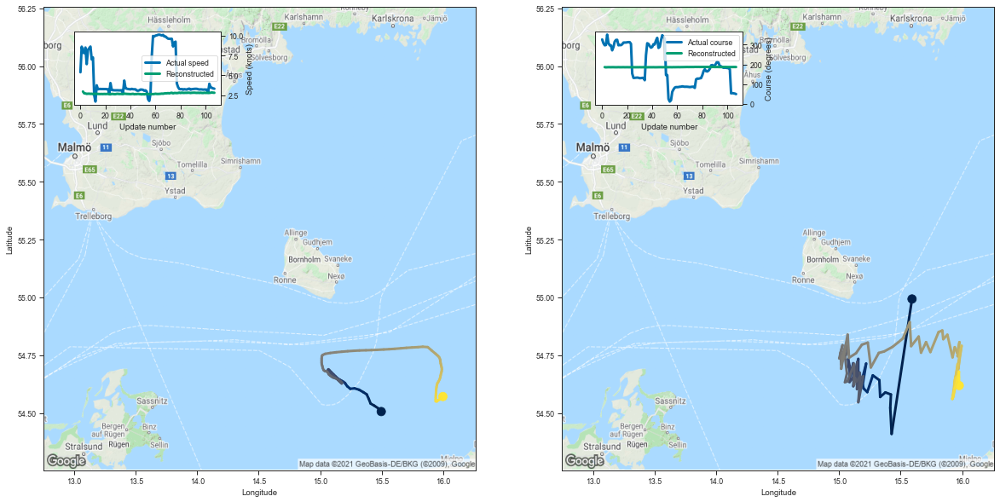

[2.946028470993042, 2.7205307483673096, 2.698716878890991, 2.6504461765289307]


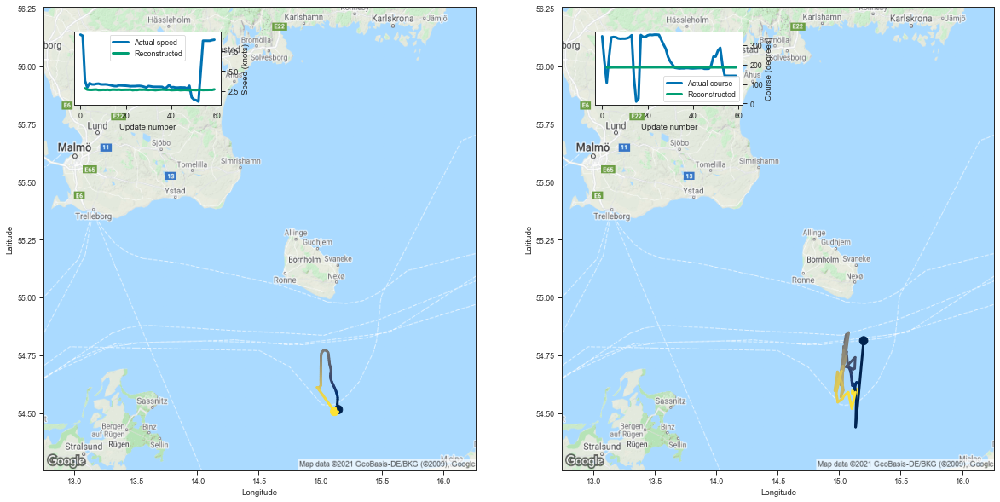

[2.813812017440796, 2.6498401165008545, 2.617030382156372, 2.61669659614563]


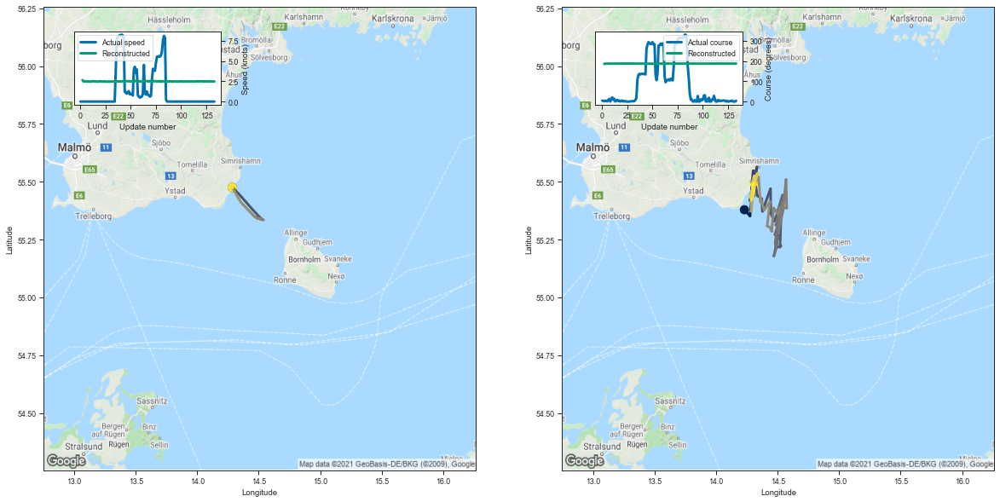

[2.6489031314849854, 2.487860918045044, 2.5022451877593994, 2.4941976070404053]


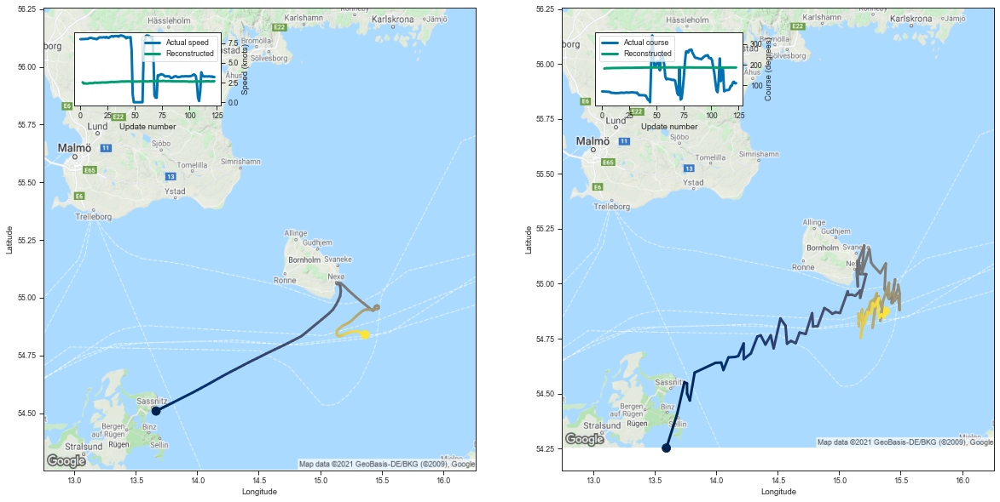

[2.5375444889068604, 2.3784868717193604, 2.399055242538452, 2.3752095699310303]


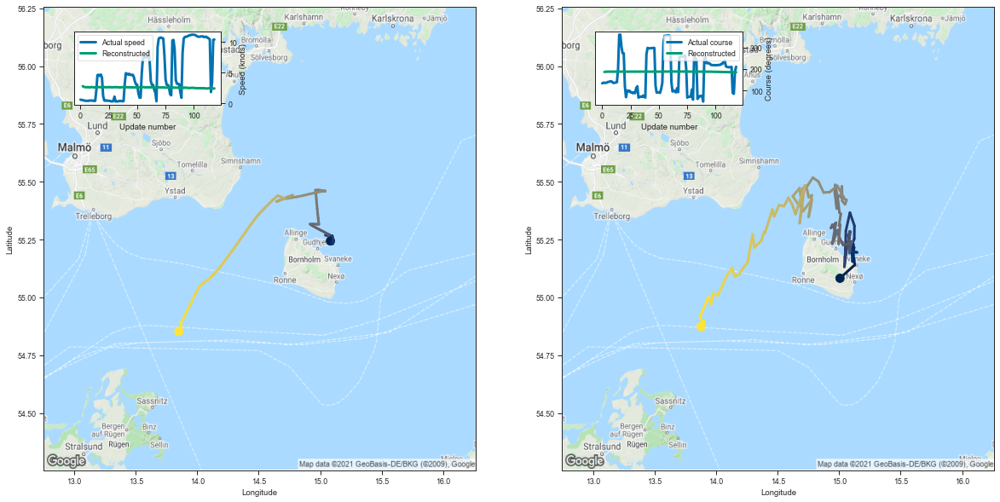

[2.7852938175201416, 2.689591646194458, 2.6339094638824463, 2.6112749576568604]


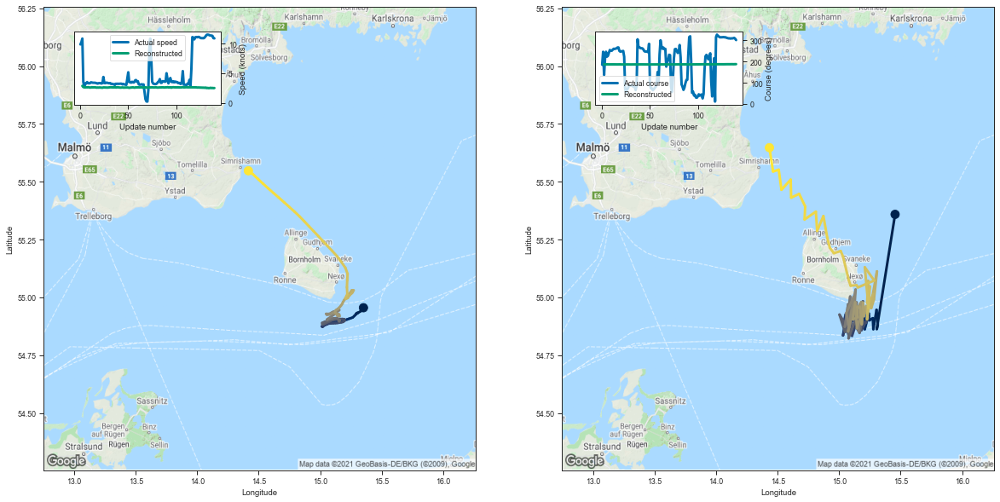

[2.890038251876831, 2.6888763904571533, 2.6587235927581787, 2.6327850818634033]


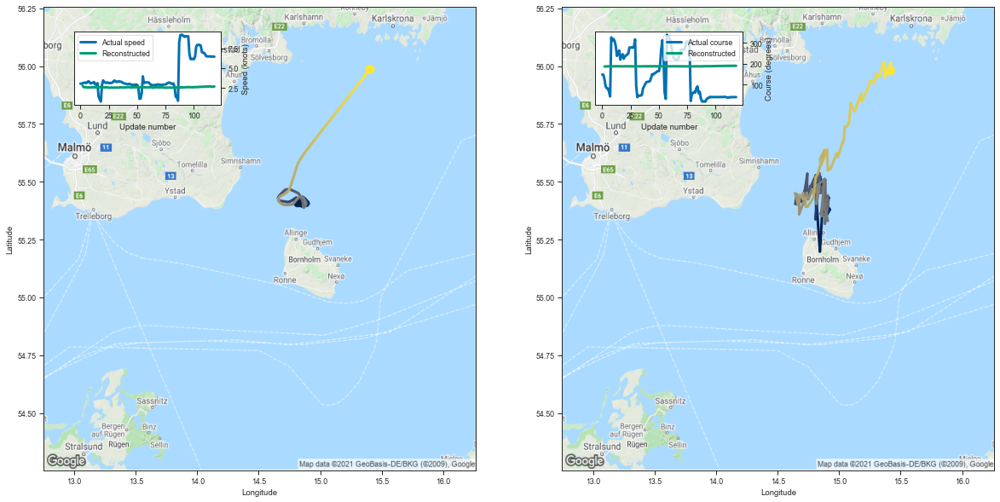

[2.7505977153778076, 2.5863091945648193, 2.5989067554473877, 2.6003034114837646]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
42,42,2268210,230069190,Fishing,141,-493.083099,-3.497043
61,61,2104788,230069190,Fishing,141,-496.287567,-3.519770
58,58,6759536,265759000,Fishing,143,-503.444855,-3.520593
92,92,4136013,261004390,Fishing,41,-144.369827,-3.521215
85,85,1987202,230069190,Fishing,134,-473.160217,-3.531046
...,...,...,...,...,...,...,...
97,97,4637185,265551874,Fishing,134,-704.299011,-5.255963
12,12,341446,211315750,Fishing,124,-652.417603,-5.261432
95,95,518910,211417590,Fishing,119,-633.741333,-5.325557
72,72,5589857,265750000,Fishing,141,-766.205383,-5.434081


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n